<h1> Trabalho prático 3: Reconhecimento de Captcha </h1>


Esthefanie Pessoa Lanza - 2015112736 <br >
João Antônio Dornelas Orlando Netto - 2014103407


Avaliação experimental:
A implementação da solução proposta foi interpretada com Python 3.5. Os experimentos foram executados em um sistema com processador Intel Core I5 7400, 8GB de memória RAM e GPU NVIDIA Geforce GTX 1060 6GB. 

<h2> Instruções de instalação das bibliotecas complementares </h2>

1 - Abrir o Anaconda Prompt <br >
2 - Criar um novo environment no Anaconda: conda create -n tensorflow python=3.5<br >
3 - Ativar o tensorflow: activate tensorflow<br >
4 - Instalar e atualizar o tensorflow:
    <ul style="list-style-type: none">
	<li>4.1 - Para o tensorflow convencional: pip install --ignore-installed --upgrade tensorflow</li>
	<li>4.2 - Para o tensorflow GPU: pip install --ignore-installed --upgrade tensorflow-gpu</li>
    </ul>
5 - Instalar o Keras: pip install keras<br >
6 - Instalar o matplotlib: pip install matplotlib<br >
7 - Instalar o open-cv: pip install opencv-python<br >

<h2> Implementação </h2>

Importação das bibliotecas necessárias para o projeto

In [1]:
import sys
import cv2
import numpy
import os

from pathlib import Path
from matplotlib import pyplot as plt
from IPython.display import clear_output
%matplotlib inline  

from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers.convolutional import Conv2D, MaxPooling2D
from keras.utils import np_utils


Using TensorFlow backend.


Definição das funções de processamento e impressão das imagens

In [2]:
#Le a imagem, converte para tons de cinza e corta no padrão correto
def correctImage(imagePath):

    img = cv2.imread(imagePath);
    img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    img = img[13:41, 12:]
    
    return img

#Divide a imagem em N partições iguais
def slice_horizontaly(img , slicesNum):
    imgArray = []
    height, width = img.shape[:2]
    sliceSize = int(width / slicesNum)
    sliceStart = 0
    for i in range(0,slicesNum):
        newSlice = img[:,sliceStart:sliceStart+sliceSize]
        imgArray.append(newSlice)
        sliceStart += sliceSize
    return imgArray

#Imprime a imagem no padrão BGR
def printImageColor( img ):
    rgbImg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(rgbImg, cmap = 'gray')
    plt.axis("off")
    plt.xticks([])
    plt.yticks([])
    plt.show()   
    return

#Imprime a imagem em tons de cinza
def printImage( img ):
    plt.imshow(img, cmap = 'gray')
    plt.axis("off")
    plt.xticks([])
    plt.yticks([])
    plt.show()   
    return

Definição das funções para tratamento do output

In [3]:
#Recebe um valor e retorna o array binário categorizado correspondente
def binaryCategory(index, setSize):
    binaryArray = [0] * setSize
    binaryArray[index] = 1
    
    return binaryArray

#Para cada elemento de um vetor de entrada, cria um vetor binário categorizado
def createCategorical(inputArray, inputList):
    outputArray = []
        
    for i in inputArray:
        outputArray.append(binaryCategory(inputList.index(i),37))
    
    return outputArray

Definição das funções de processamento dos datasets

In [4]:
#Trata o captcha atual e adiciona suas partições no vetor de saída
def addCaptcha(imageDirectory, textDirectory, imageFile, textFile, inputArray, outputArray):
    
    fileContent = open(textDirectory + "/" + textFile, "r").read()
    inputImage = correctImage(imageDirectory + "/" + imageFile)
    imageSlices = slice_horizontaly(inputImage, 6)

    for i in range(len(imageSlices)):
        inputArray.append(imageSlices[i])
        outputArray.append(fileContent[i])

#Cria um novo dataset, recebendo como parâmetro de entrada o diretório de imagens e o 
#diretório contendo a classificação de cada imagem
def createDataset(imageDirectory, textDirectory):
    
    inputArray, outputArray = [], []
    
    directory = Path(imageDirectory)
    fileList = [f for f in directory.glob('**/*') if f.is_file()]
    
    for f in range(0,len(fileList)):
        imageFile = str(fileList[f]).split("\\")[-1]
        clear_output(wait=True)
        print(str(f+1) + "/" + str(len(fileList)))
        textFile = imageFile.replace(".jpg", ".txt")
        addCaptcha(imageDirectory, textDirectory, imageFile, textFile, inputArray, outputArray)
        
    return numpy.array(inputArray), numpy.array(outputArray)

Definição dos diretórios de treino, validação e teste.

In [5]:
#Caminho dos diretórios que serão usados pela rede

train_directory = 'dados/CAPTCHA-10k/treinamento'
validation_directory = 'dados/CAPTCHA-10k/validacao'
test_directory = 'dados/CAPTCHA-10k/teste'
labels = 'dados/CAPTCHA-10k/labels10k'

Criação do dataset de entrada, usando as imagens do diretório de treino. Para cada imagem existente no diretório, dividimos a mesma em seis partes iguais e o mesmo foi realizado para o arquivo de texto. Dessa forma, para cada posição do vetor de entradas, temos a imagem de uma letra e o caractere correspondente.

8000/8000
Imagem exemplo: 


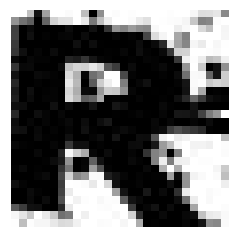

Letra correspondente:R


In [6]:
#Cria um novo dataset, contendo as imagens de entrada e de saída
inputArray, outputArray = createDataset(train_directory, labels)

#Imprime um exemplo de valor lido 
print("Imagem exemplo: ")
printImage(inputArray[0])
print("Letra correspondente:" + outputArray[0])

#Normaliza os dados lidos
inputArray = inputArray.reshape(inputArray.shape[0], 28, 28, 1)
inputArray = inputArray.astype('float32')/255

Para cada caractere do vetor de saída, convertemos seu valor para um vetor binário de 37 posições. O índice de cada posição com o valor 1 corresponde ao caractere especificado no vetor inputList. 

In [7]:
#Lista usada para categorização binária de cada saída
inputList = ['0','1','2','3','4','5','6','7','8','9','A','B','C','D','E','F','G','H','I','J','K','L','M','N','O','P','Q','R','S','T','U','V','W','X','Y','Z','?']

print("Letra correspondente: " + outputArray[0])

#Converte a saída em um vetor categórico binário
outputArray = createCategorical(outputArray, inputList)

print("Vetor binário:")
print(outputArray[0])



Letra correspondente: R
Vetor binário:
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]


Construção da rede neural

In [8]:
#Cria camada sequencial
model = Sequential()

#Cria a camada de entrada
model.add(Conv2D(256, (3, 3), strides=(1, 1), activation='relu', padding='same', input_shape=(28,28,1)))

#Cria as camadas ocultas
model.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2), padding='same'))
model.add(Dropout(0.25))

#Cria a camada totalmente conectada
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(37, activation='softmax'))

#Imprime um sumário da rede construída
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 28, 28, 256)       2560      
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 28, 28, 256)       590080    
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 14, 14, 256)       0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 14, 14, 256)       0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 50176)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               12845312  
_________________________________________________________________
dropout_2 (Dropout)          (None, 256)               0         
__________

Criação do dataset de validação, utilizando os mesmos procedimentos do dataset de treinamento.

In [9]:
#Cria um novo dataset utilizando o diretório com as imagens e validação
inputValidacao, outputValidacao = createDataset(validation_directory, labels)

#Normaliza o dataset criado
shapedinputValidacao = inputValidacao.reshape(inputValidacao.shape[0], 28, 28, 1)
shapedinputValidacao = shapedinputValidacao.astype('float32')/255

#Cria a categorização binária para cada valor da saída
outputValidacao = createCategorical(outputValidacao,inputList)


1000/1000


Compilação do modelo e treinamento da rede, usando o dataset de treino. Nesse passo, também é utilizado o dataset de validação para validar os dados.

In [10]:
#Compila o modelo
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

#Executa a rede, com um batch size de 50, executando em 10 epocas, e validando os dados com o dataset de validação
response = model.fit(inputArray, outputArray, 
          batch_size=50, epochs=10, verbose=1, validation_data=(shapedinputValidacao, outputValidacao))

Train on 48000 samples, validate on 6000 samples
Epoch 1/10
48000/48000 [==============================] - 68s 1ms/step - loss: 0.7766 - acc: 0.7715 - val_loss: 0.2290 - val_acc: 0.9243
Epoch 2/10
48000/48000 [==============================] - 61s 1ms/step - loss: 0.3276 - acc: 0.8967 - val_loss: 0.1881 - val_acc: 0.9403
Epoch 3/10
48000/48000 [==============================] - 61s 1ms/step - loss: 0.2522 - acc: 0.9200 - val_loss: 0.1693 - val_acc: 0.9455
Epoch 4/10
48000/48000 [==============================] - 61s 1ms/step - loss: 0.2112 - acc: 0.9294 - val_loss: 0.1714 - val_acc: 0.9450
Epoch 5/10
48000/48000 [==============================] - 61s 1ms/step - loss: 0.1801 - acc: 0.9411 - val_loss: 0.1718 - val_acc: 0.9412
Epoch 6/10
48000/48000 [==============================] - 61s 1ms/step - loss: 0.1602 - acc: 0.9471 - val_loss: 0.1652 - val_acc: 0.9470
Epoch 7/10
48000/48000 [==============================] - 63s 1ms/step - loss: 0.1422 - acc: 0.9519 - val_loss: 0.1673 - val_acc:

Criação do dataset de testes, utilizando os mesmos procedimentos do dataset de treinamento e validação.

In [11]:
#Cria os datasets com os arquivos do diretório de testes
inputTeste, outputTeste = createDataset(test_directory, labels)

#Normaliza os dados do diretório de testes
shapedinputTeste = inputTeste.reshape(inputTeste.shape[0], 28, 28, 1)
shapedinputTeste = shapedinputTeste.astype('float32')/255

#Converte as saídas para categorização binária
outputTeste = createCategorical(outputTeste,inputList)

1000/1000


Avaliação do modelo já treinado em relação ao dataset de teste (por caractere)

In [12]:
#Avalia a acurácia do modelo, com o dataset de teste
score = model.evaluate(shapedinputTeste, outputTeste, verbose=1)
print(score)

6000/6000 [==============================] - 3s 486us/step
[0.20008142901708684, 0.94550000000000001]


Encontramos o primeiro captcha no diretório de teste especificado

In [13]:
#Encontra o primeiro captcha no diretório especificado
firstCaptchaFile = (os.listdir(test_directory)[0])
currentCaptcha = int(firstCaptchaFile.split(".")[0])
print("Iniciamos a validação pelo CAPTCHA de número: " + str(currentCaptcha))

Iniciamos a validação pelo CAPTCHA de número: 9001


Para cada captcha, identifica-se quantos caracteres foram assimilados corretamente, e gera-se um vetor de saída contendo quantos captchas acertaram um número N de caracteres. 

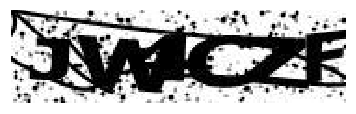

JW4CZF


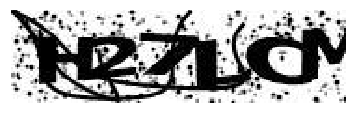

H27LCM


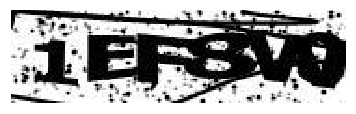

1EF8V0


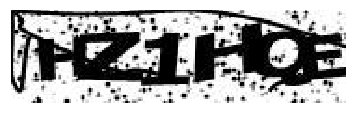

HZ1HQE


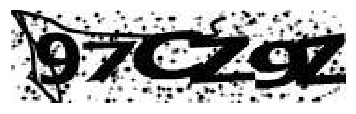

97CZ9Z


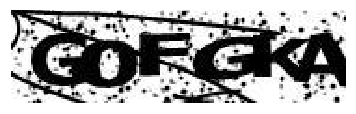

G0FGKA


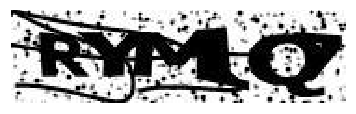

RYM1C7


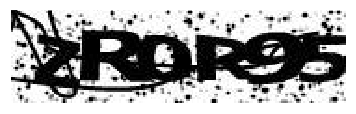

ZROR95


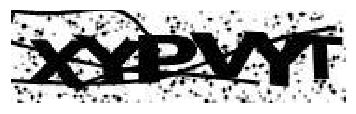

XYPVYT


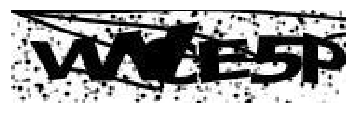

VW1E5P


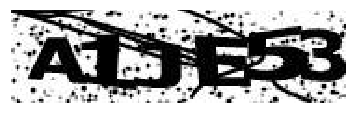

A1JE53


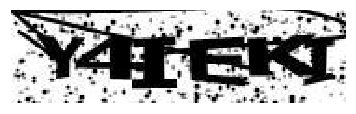

Y4IEKJ


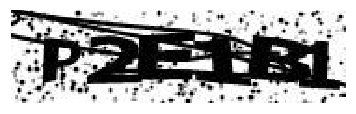

P2E1B1


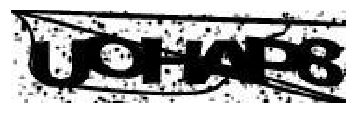

UOHAP8


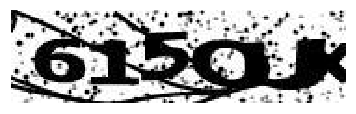

615QLK


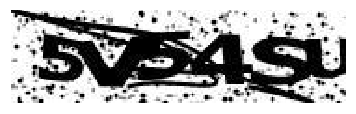

5V54SU


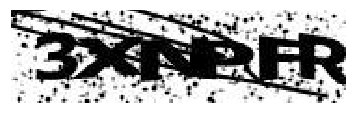

3XNPFR


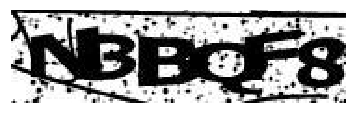

NBBQF8


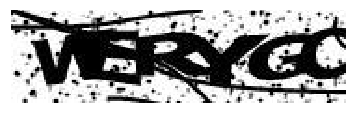

WERYGO


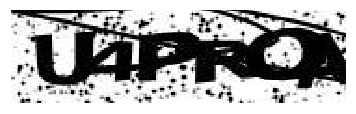

U4PRCA


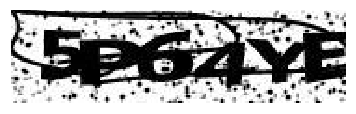

5P64YE


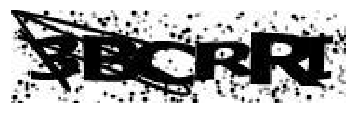

3BCRRI


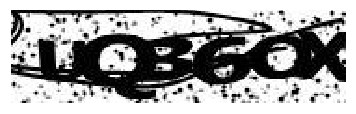

UOB6OX


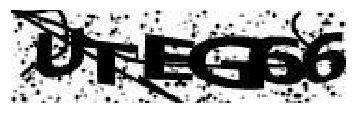

0TEG66


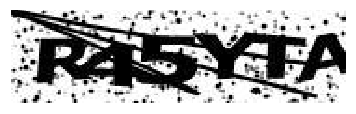

R45YTA


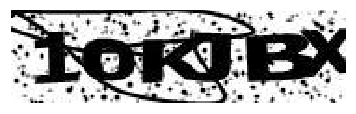

10KJBX


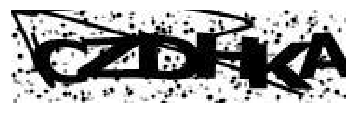

CZDHKA


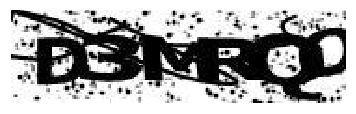

D3MRQO


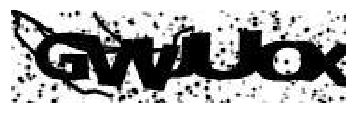

GWUUCX


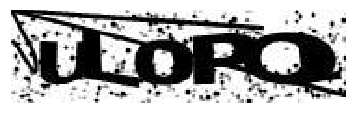

UL0PCI


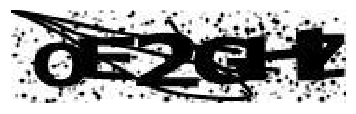

OE2GHZ


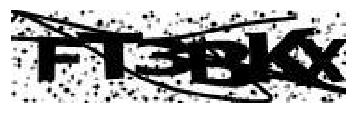

FT3BKX


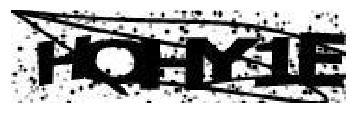

HOHY1E


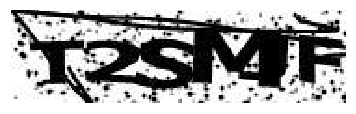

T2SMJF


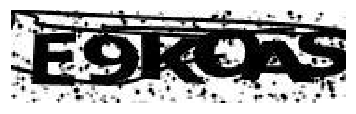

E9KOAS


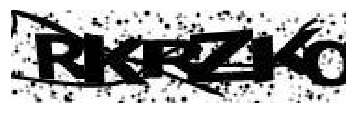

RKRZKO


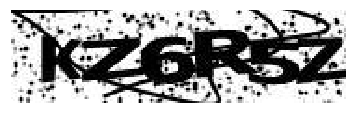

KZ6R5Z


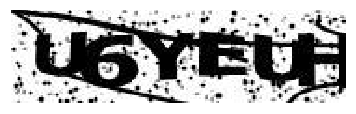

U6YEUH


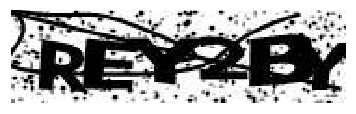

REY2BY


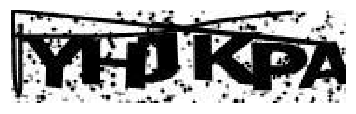

YHJKPA


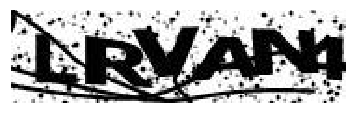

LRVAP4


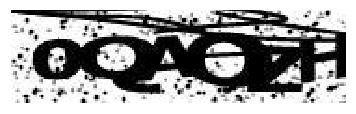

0QAQPH


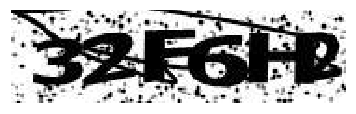

32F6H2


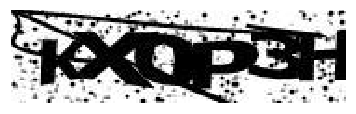

KX0P3H


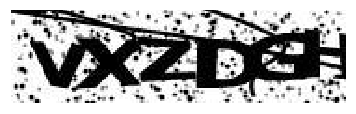

VXZDGH


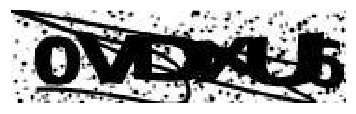

0VDXU6


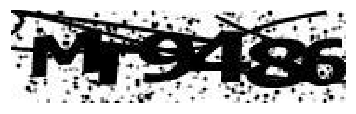

MH9486


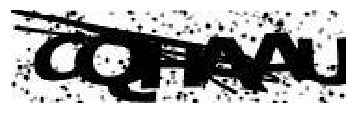

CQHAAU


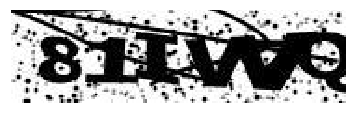

81IWVQ


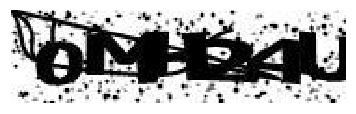

0MH24U


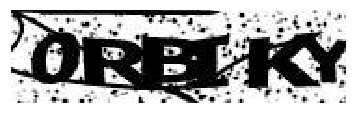

0RBIKY


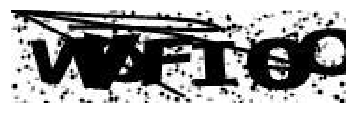

W?FIOO


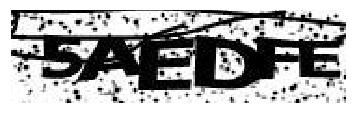

5AEDFE


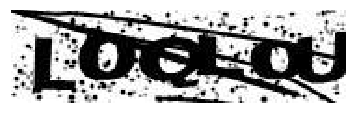

L0QL0U


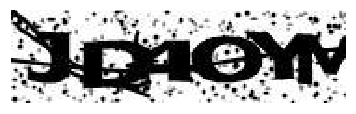

JD4OYM


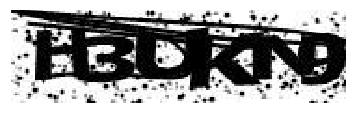

H3DKN9


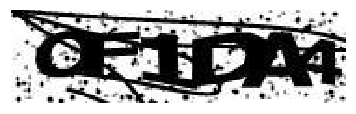

OF1DA4


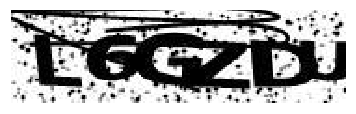

L6GZDU


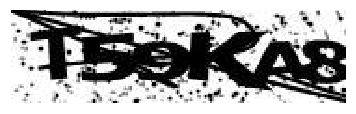

T59KA8


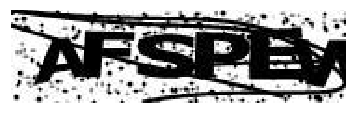

AFSPEW


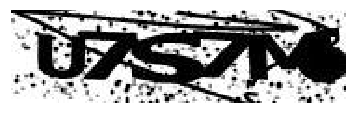

U7S7M6


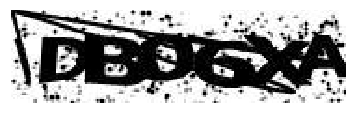

DB06XA


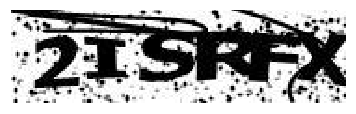

2ISRFX


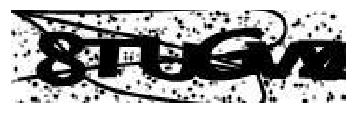

8TUGVZ


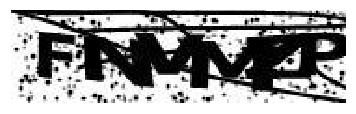

FNMMZP


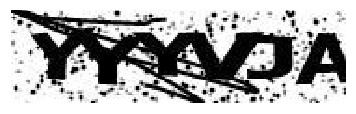

YYYVJA


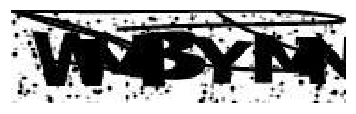

WMBYMN


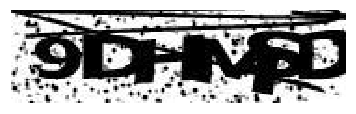

9DHMSD


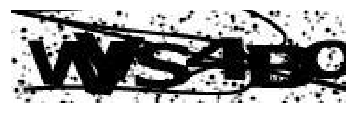

WWS4BO


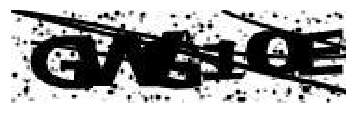

GWG1OE


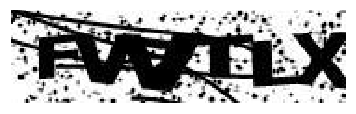

FW7TLX


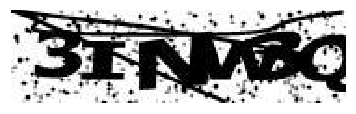

3INV3Q


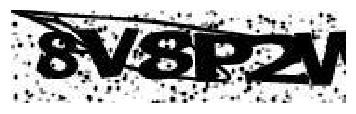

8V8P2W


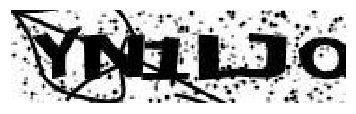

YN1LJO


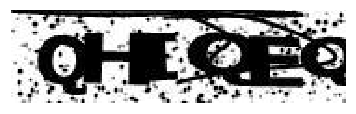

QHIQEQ


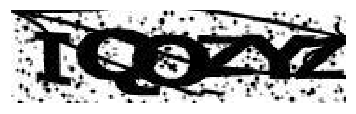

IQQZYZ


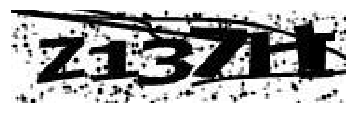

Z137HI


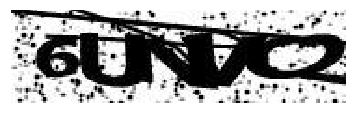

6UNVC2


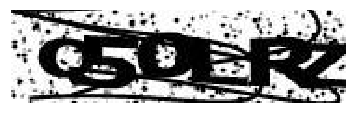

Q50LRZ


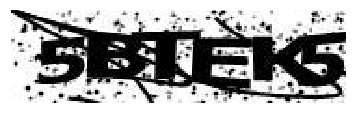

5BTEK5


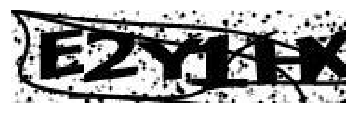

E2Y1HX


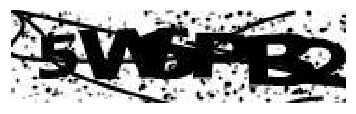

5WOPB2


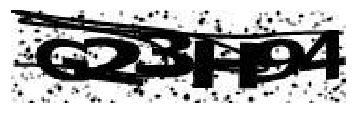

G23H94


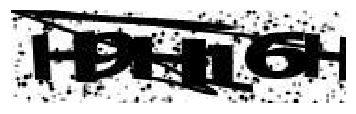

H9HT6H


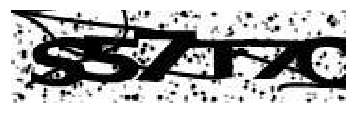

S57T7Q


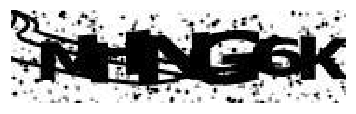

MHNG6K


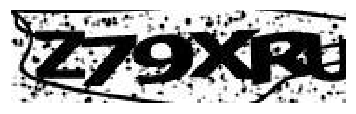

Z79XRU


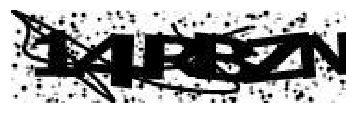

14RBZN


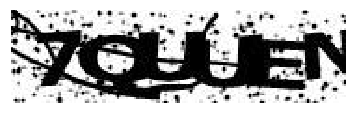

7QUUEN


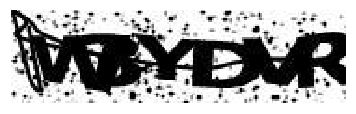

W3YDVR


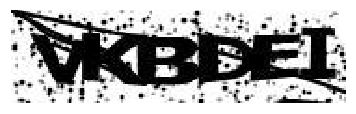

VKBDEI


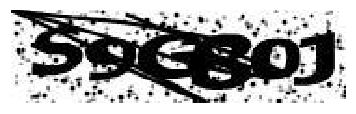

59G80J


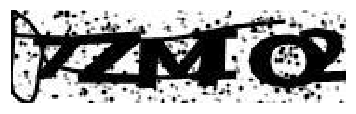

7ZMIQ2


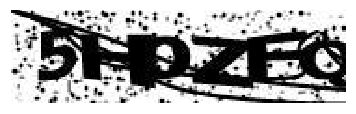

5H0ZFQ


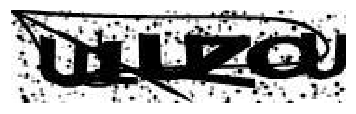

U1UZCU


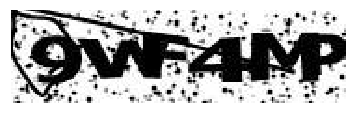

9WF4MP


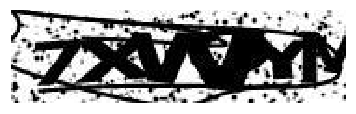

7XWVYM


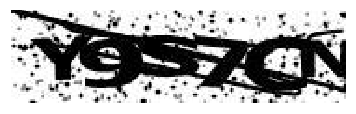

Y9S7CN


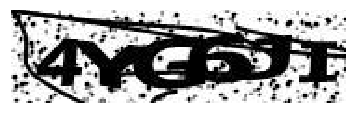

4YG6JI


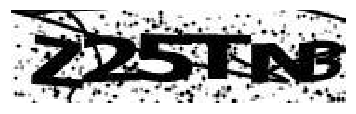

Z25TNB


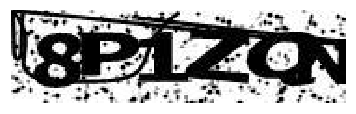

8P1ZQN


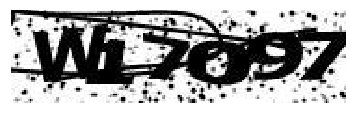

W17O97


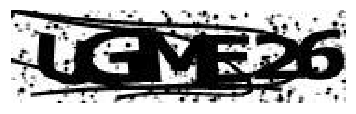

UGME26


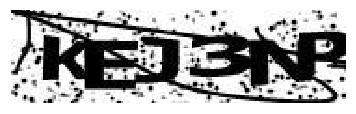

KEJ3NP


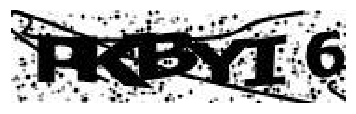

PKBYI6


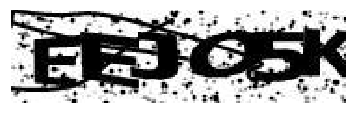

EEJO5K


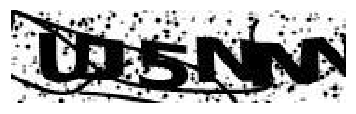

UJ5NNN


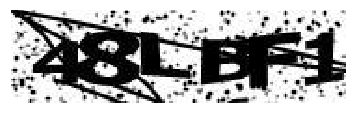

48LBF1


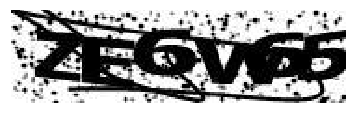

ZE6W65


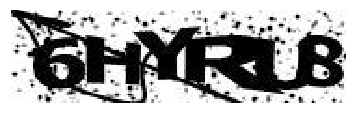

6HYRL8


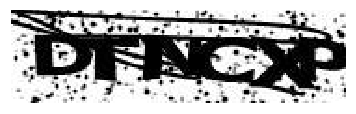

DTNCXP


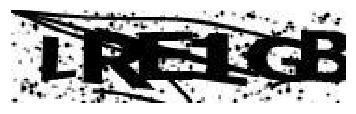

LRE1GB


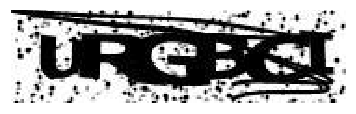

URGBCI


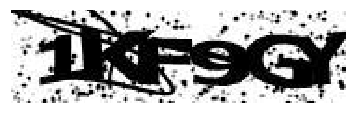

1KF9GY


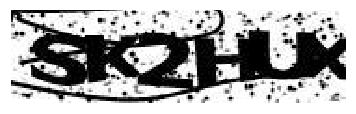

SK2HUX


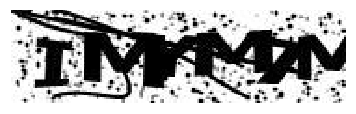

IMYM7M


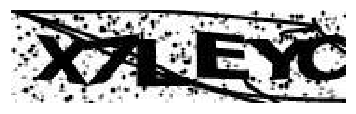

X7LEYC


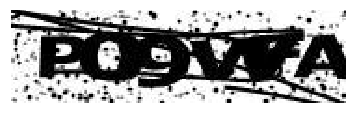

P09W7A


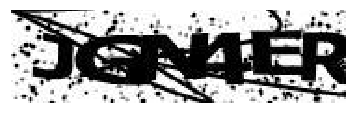

JGN4ER


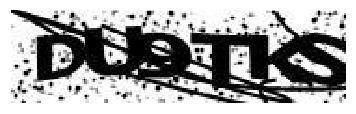

DU9TKS


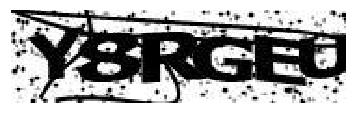

Y8RGEU


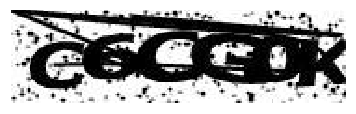

C6CGOK


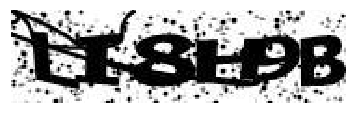

LI8H9B


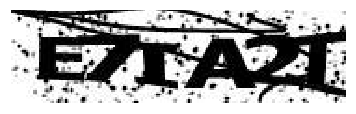

E7IA2T


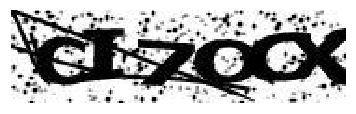

CI7OCX


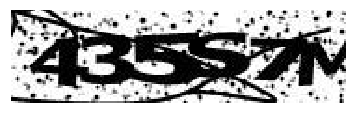

435S7M


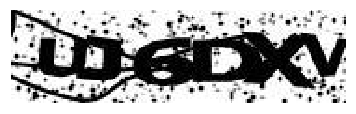

UJ6DXV


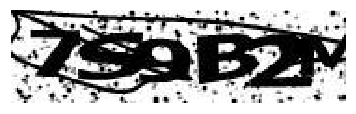

7S9B2M


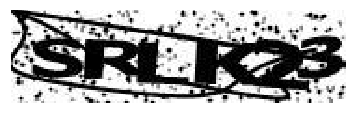

SRLK23


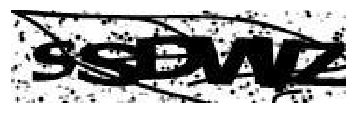

SSDWWZ


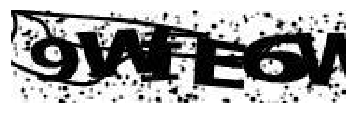

9WIE6W


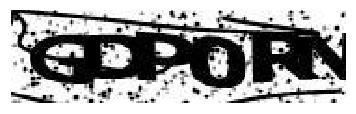

GDP0RN


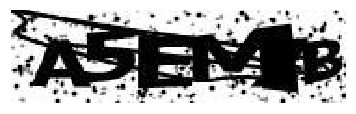

A5EM7B


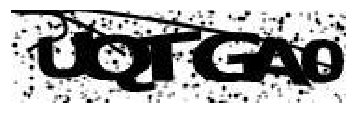

UQTGA0


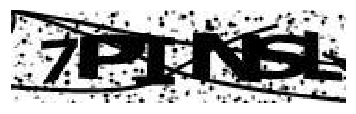

7PINSL


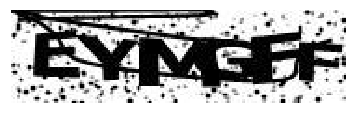

EYMGFF


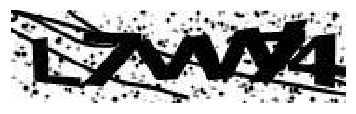

L7VV74


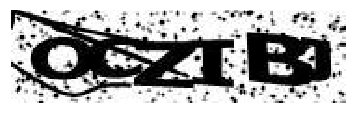

OOZIBJ


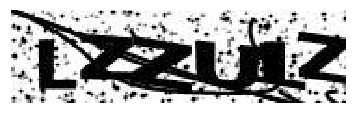

LZZU1Z


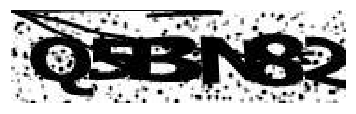

Q5BN82


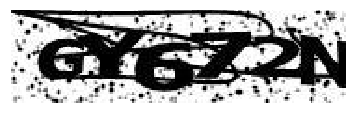

CY672N


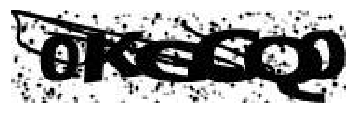

0KGCQ0


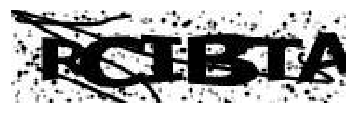

RCIBTA


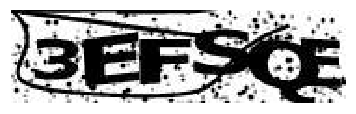

3EFSQE


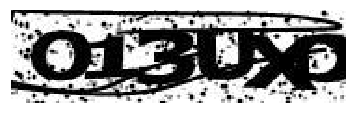

O13UXD


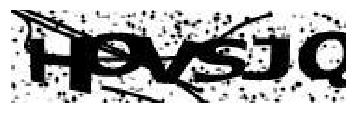

HOVSJQ


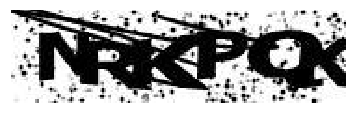

NRKPQK


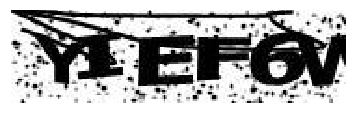

YIEF6W


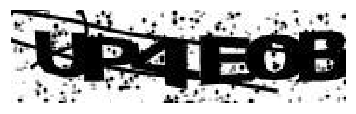

UP4E0B


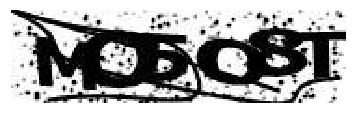

MO5CBT


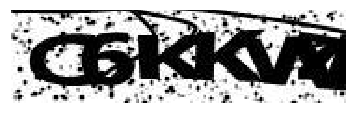

C6KKW7


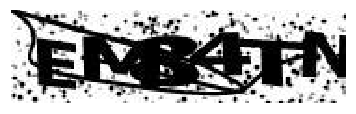

EM84TN


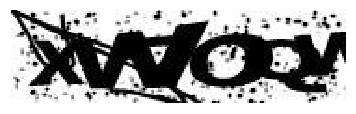

XW7QQW


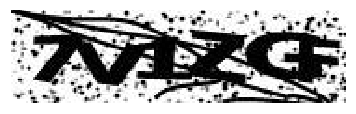

7V1ZGF


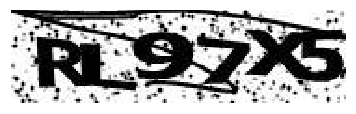

RL97X5


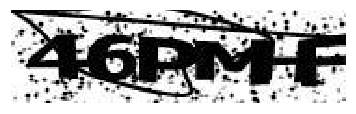

46PMHF


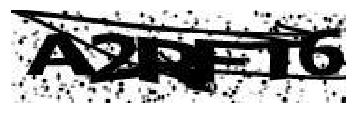

A2RFT6


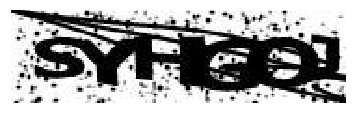

SYHGOJ


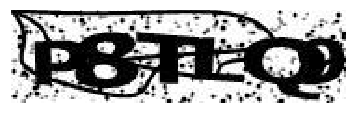

P8TLQ9


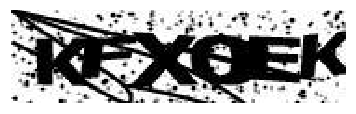

KFX0EK


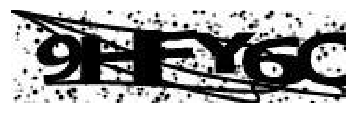

9HFY6C


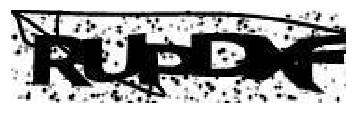

RUPDXF


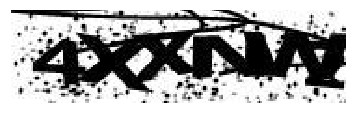

4XXNWZ


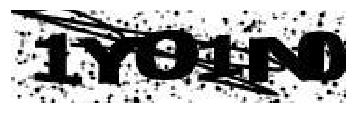

1Y01N0


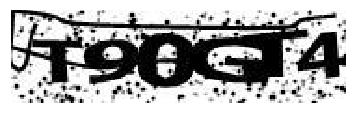

T90GT4


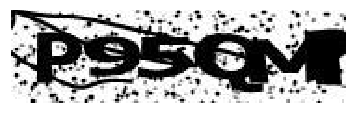

P95QM?


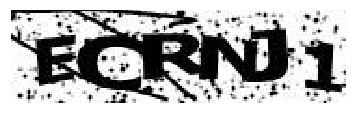

ECRNJ1


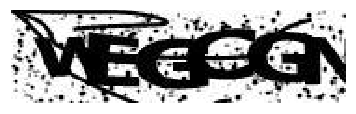

WEGCGN


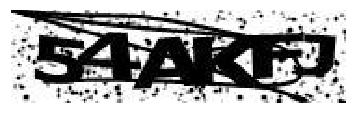

54AKFJ


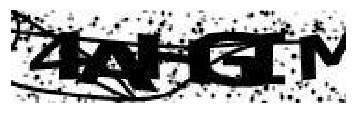

4AHGIM


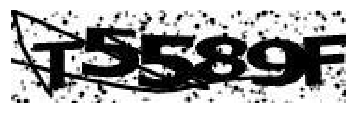

T5589F


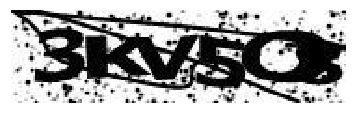

3KV5CS


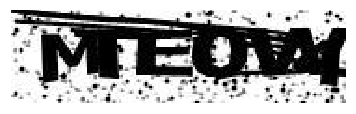

MTE0W4


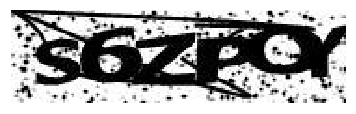

S6ZPCY


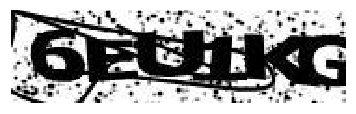

6EU1KG


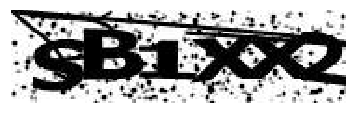

SB1XX2


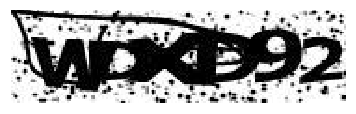

WDXD92


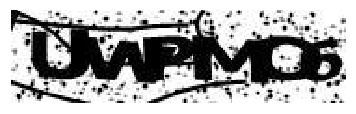

UWPMC6


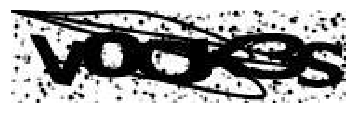

V0QK3S


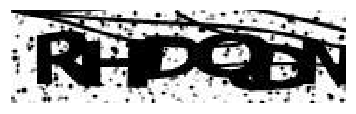

RHDQDN


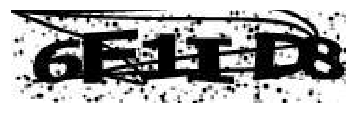

6F1ID8


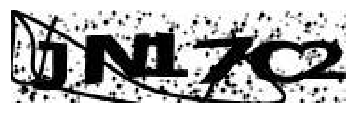

JN17C2


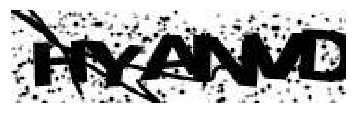

HYANVD


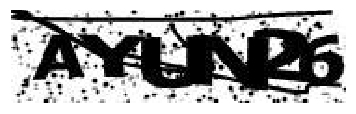

AYUN26


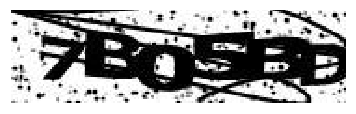

7BQ5BD


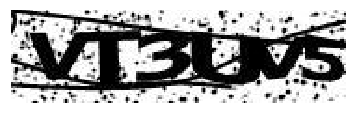

VT3UV5


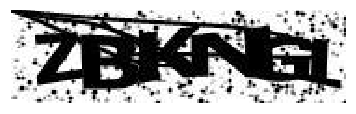

ZBKNG1


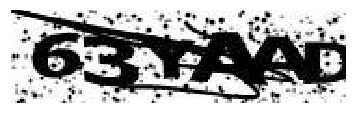

63YAAD


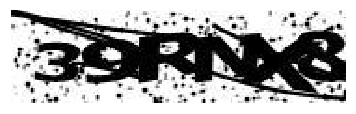

39RNX8


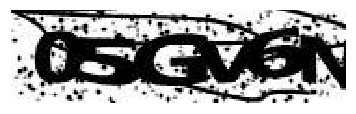

05GV6N


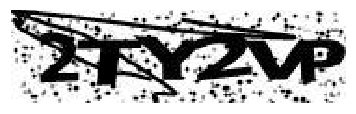

2TY2VP


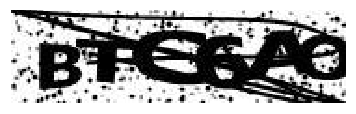

BTG6AO


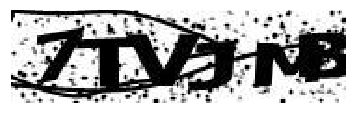

7TVJMB


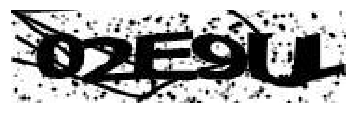

02E9UL


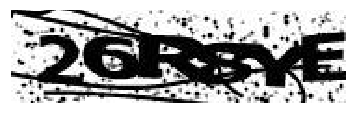

26R8YE


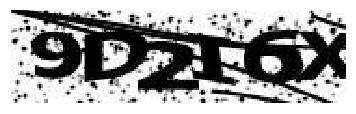

9D2T6X


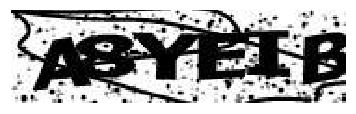

A8YEIB


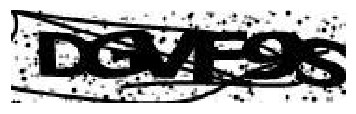

DGVF9S


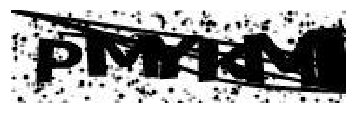

PMYKM?


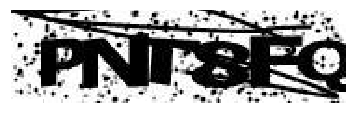

PNT8PQ


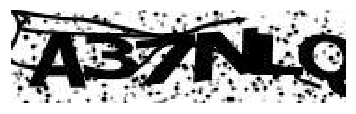

A37NLQ


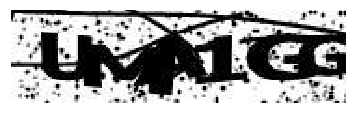

UMA1GG


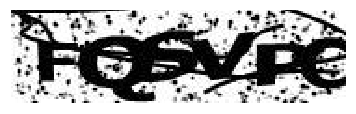

FOSVPO


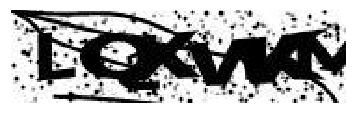

LQXWKM


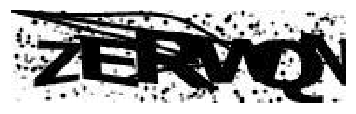

ZERWQN


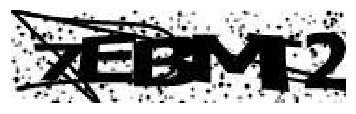

7EBMT2


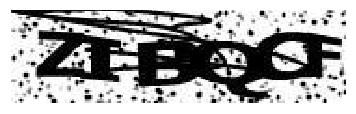

ZIBQCF


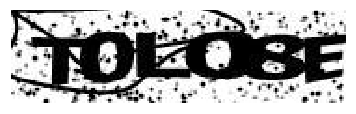

T0L08E


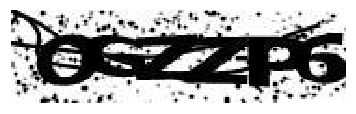

OGZZP6


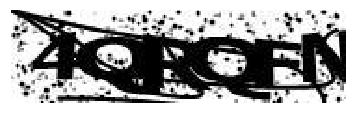

4QRQFN


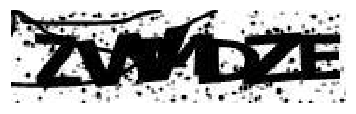

ZWMDZE


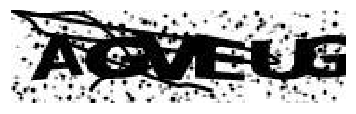

AGVEUG


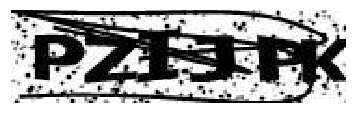

PZIJPK


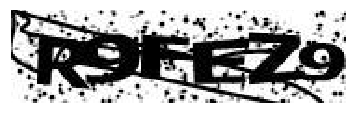

R9FEZ9


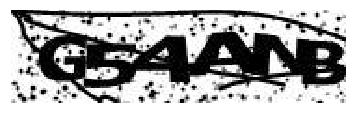

G54ANB


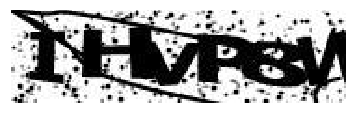

IHVP8W


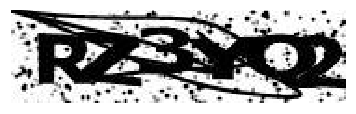

RZ3YQ2


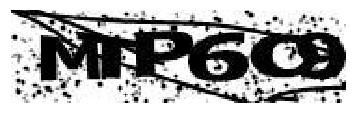

MTP6C9


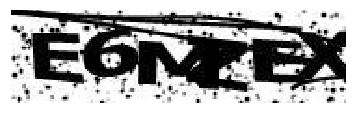

E6MZEX


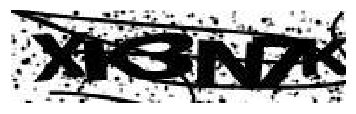

XK3N7K


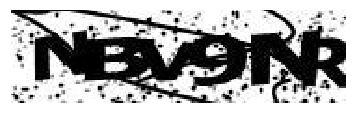

NBV9NR


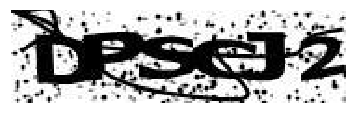

DPSCJ2


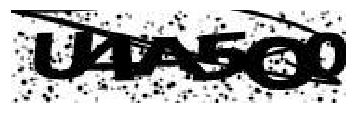

U4A5Q0


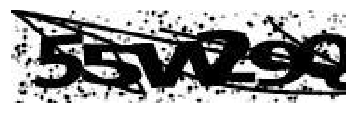

55W29Q


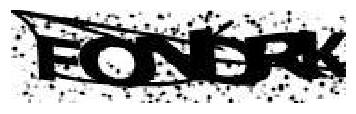

FQNDRK


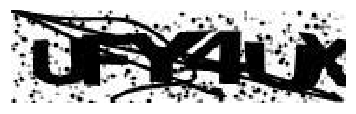

UFY4UX


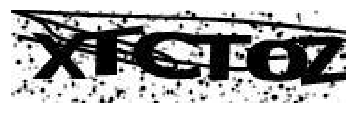

XTCT0Z


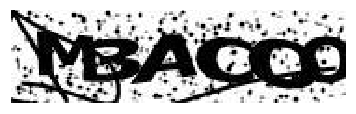

M3ACQO


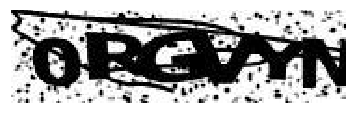

0RGVYN


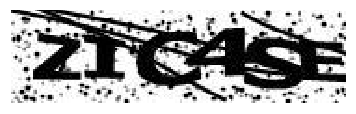

ZIC4SE


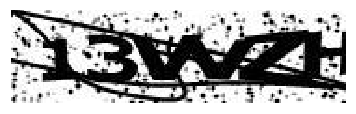

13VVZH


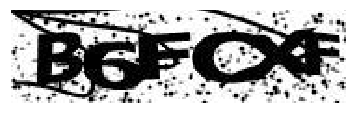

B6FCXF


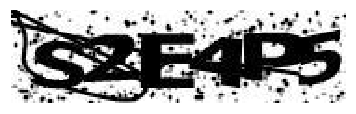

S2E4P5


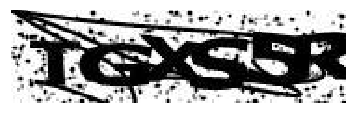

TGXS5R


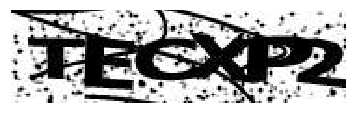

TECXP2


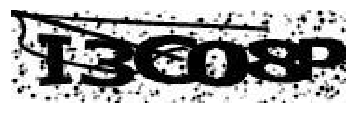

I3C08P


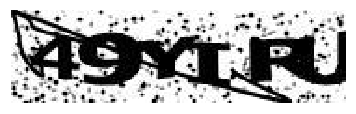

49YIRU


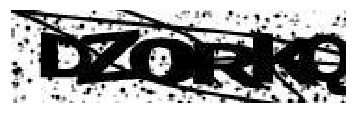

DZORKQ


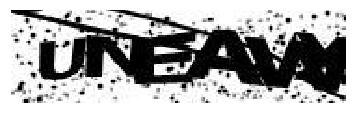

UNEAVX


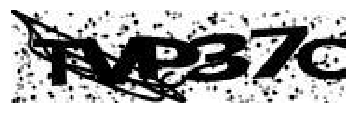

TVP37C


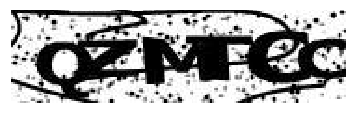

OZMTCC


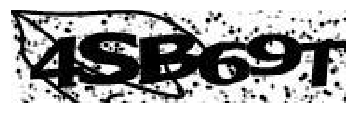

4SB69T


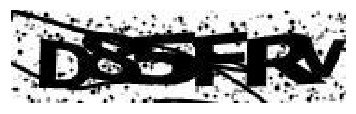

D85FRV


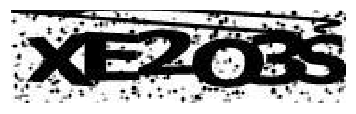

XE2Q3S


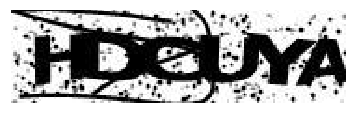

HDCUYA


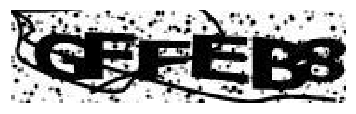

GFFEB8


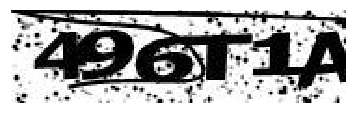

496T1A


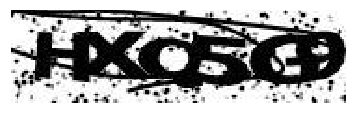

HXQ5G9


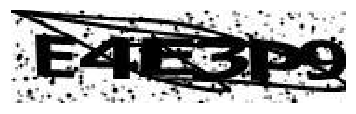

E4E3P9


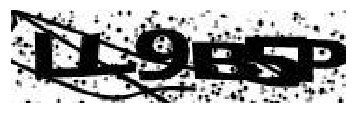

LL9B5P


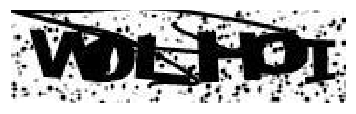

W0LHOI


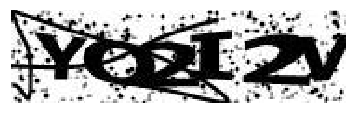

YQ2I2V


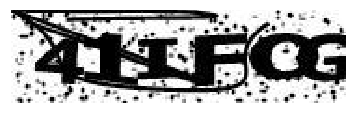

41IFCG


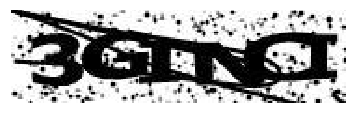

3GINCI


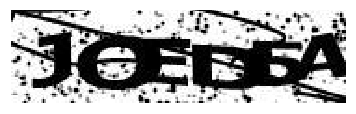

JQED5A


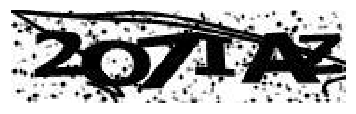

2O7IAZ


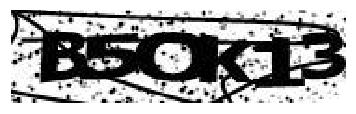

B5OK13


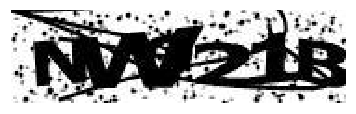

NW021B


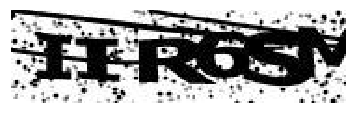

IIR6SM


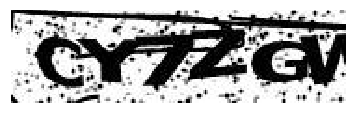

CY7ZGW


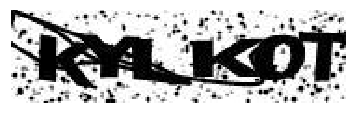

KYLK0T


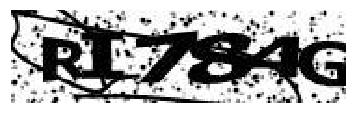

RI784G


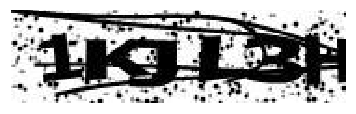

1KJL3H


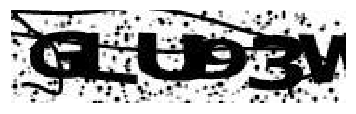

GLU93W


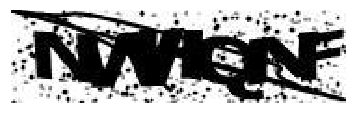

NWHQNF


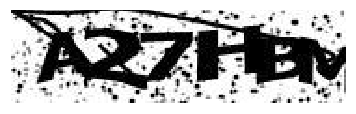

A27HBM


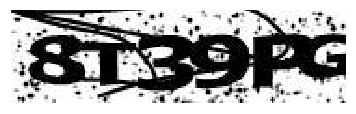

8T39PG


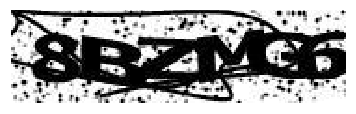

8BZMG6


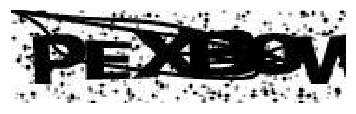

PEXB0W


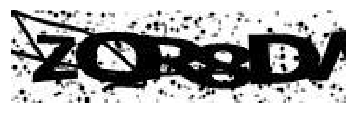

ZQR8DW


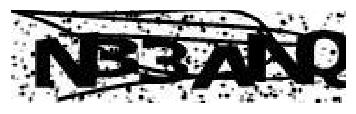

N33ANQ


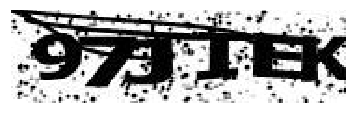

97JIEK


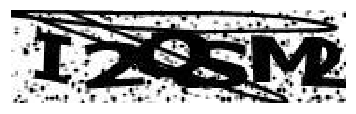

I2QSM2


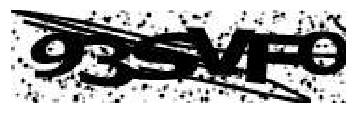

93SVFO


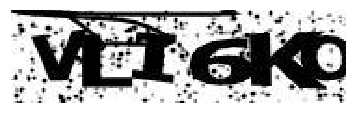

VLI6KO


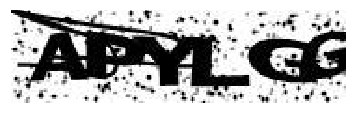

APYLGG


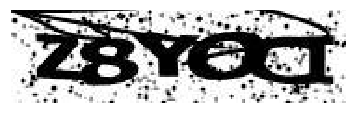

Z8YOCI


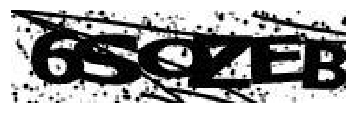

6SOZEB


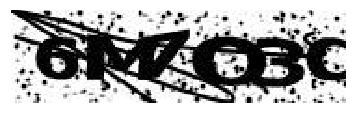

6M7OBO


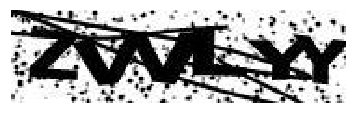

ZVVLYY


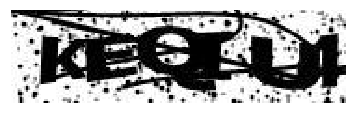

KEQIL4


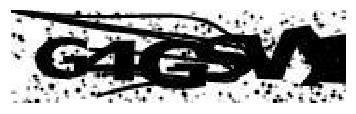

G4GSWX


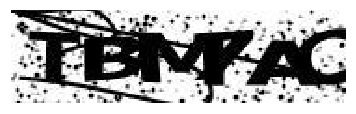

TBMYAC


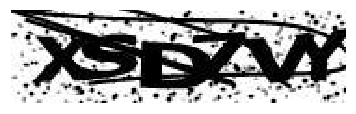

XSD7VY


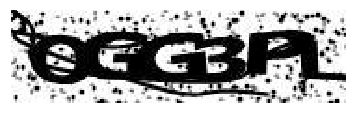

OGG3PL


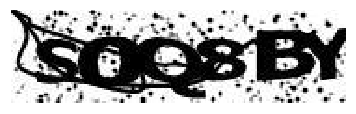

S0Q8BY


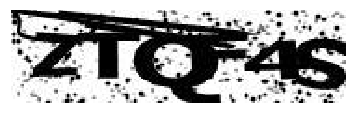

ZTQF4S


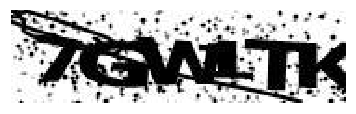

7GW1TK


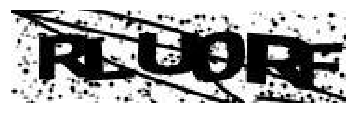

RLU0RF


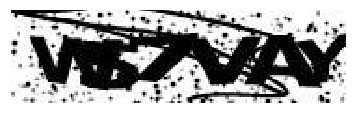

W57VAY


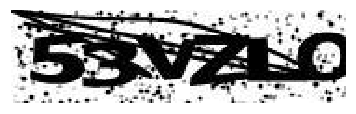

53VZL0


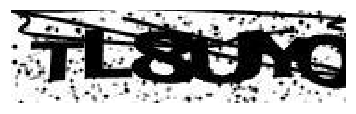

TL8UYQ


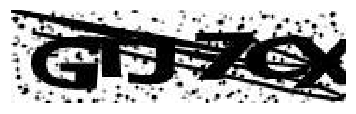

GTJ7CX


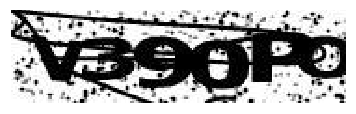

V390PO


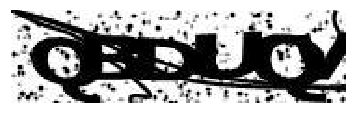

QBDUQV


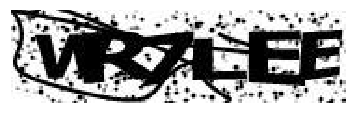

WR7LEE


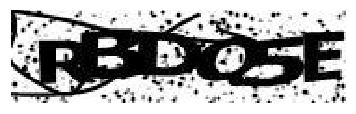

RBDQ5E


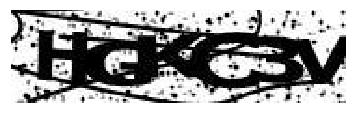

HGKC3V


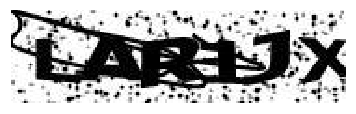

LAR1JX


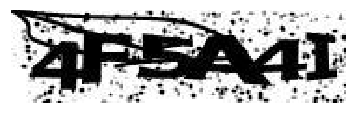

4F5A4I


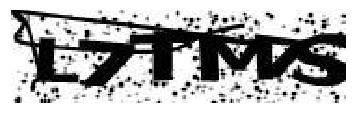

L7TM7S


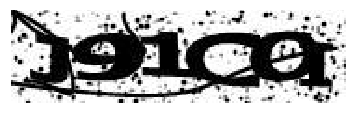

J91CCI


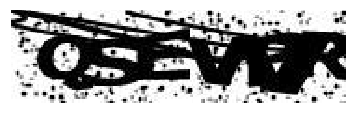

QSEVBR


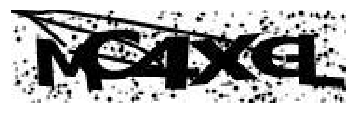

MC4XGL


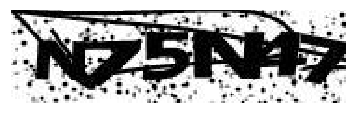

N75N47


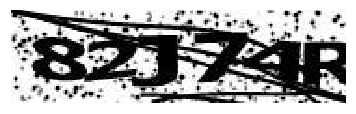

82J74R


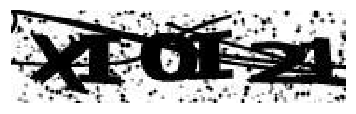

XIOI21


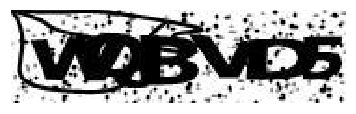

WQBVD5


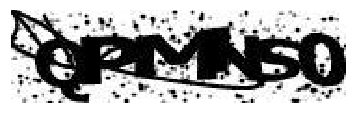

OPMNS0


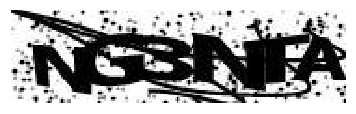

NG3NTA


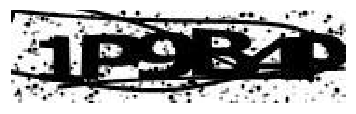

1P9B4P


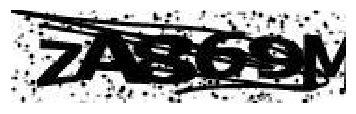

ZA869M


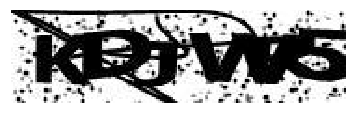

KDJVR5


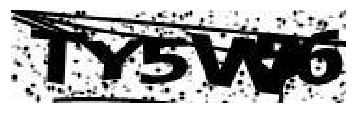

TY5WB6


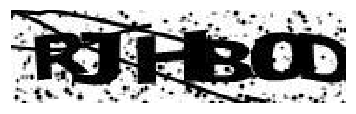

RJHBOD


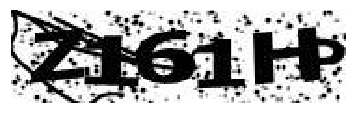

Z161HP


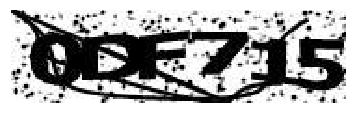

0DF715


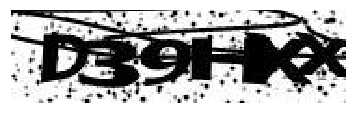

D39HXX


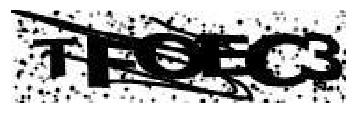

TFOEC3


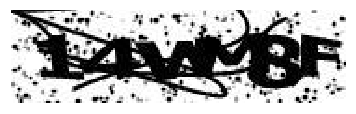

14WM8F


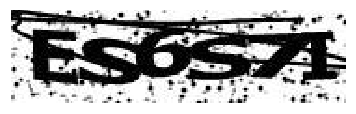

ES6S7I


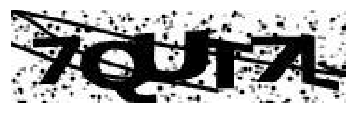

7QUT7L


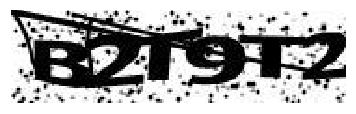

B2T9T2


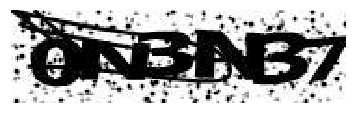

0N3NB7


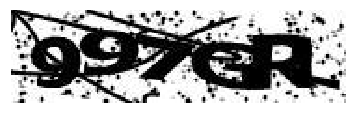

997GRL


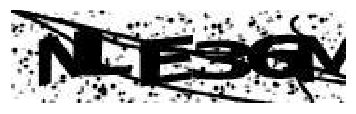

NLE36M


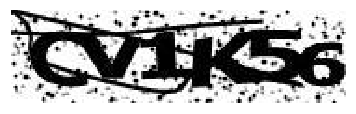

CV1K56


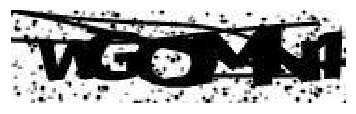

WGQMN4


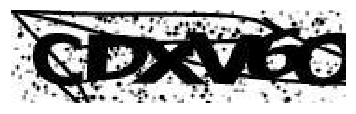

CDXV6O


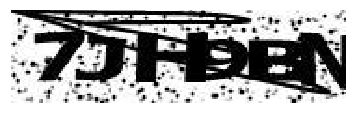

7JH9BN


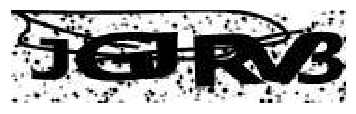

JGJRV3


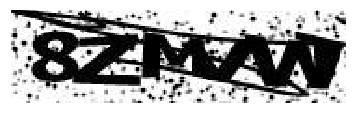

8ZMVVT


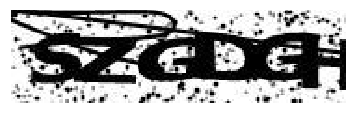

SZGDGH


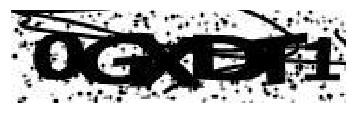

0GXDT1


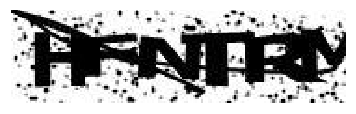

HFNTRM


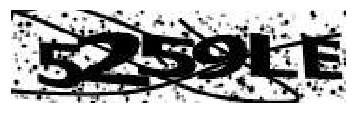

5259LE


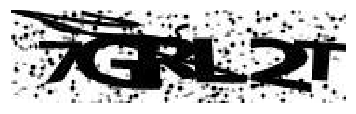

7GRL2T


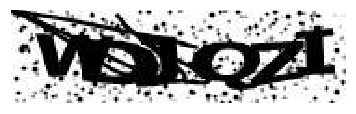

WDJQZI


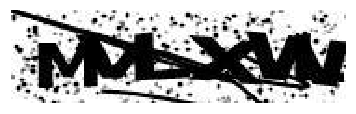

MVLXWW


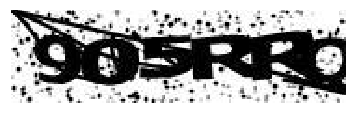

9O5RRQ


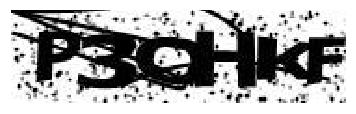

P3OHKF


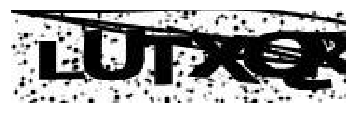

LUTXQ8


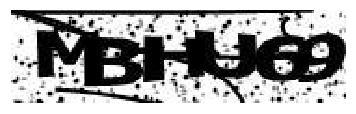

MBHU69


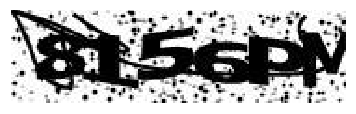

8156PM


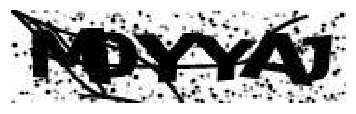

M0YYAJ


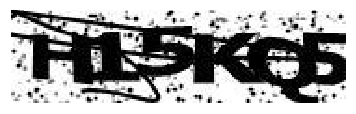

H15KQ5


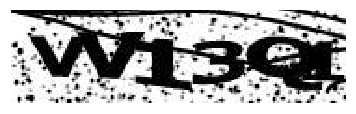

VV13Q1


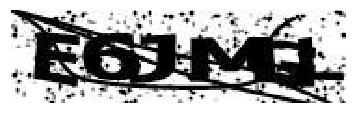

E6JMGL


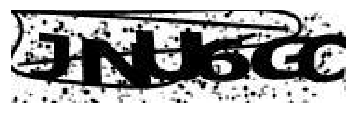

JNU6GC


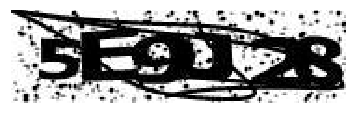

5E9J28


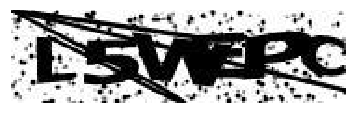

L5WEPC


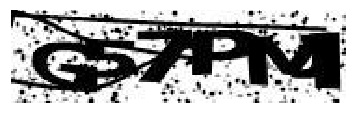

G57PMJ


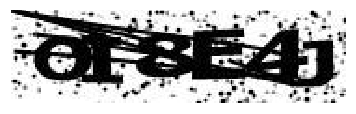

OI8E4J


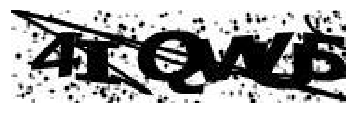

4IQWV5


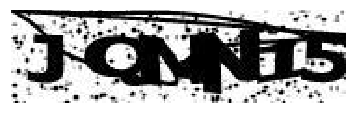

JQMN15


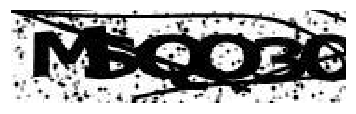

MSQQ3O


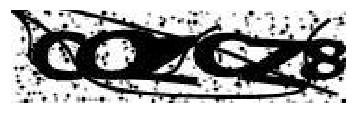

OO2CZ8


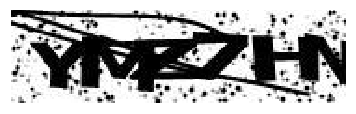

YMZ7HN


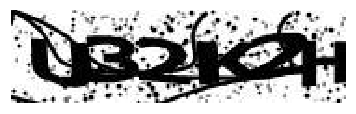

U32K2H


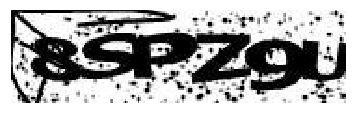

8SPZ9U


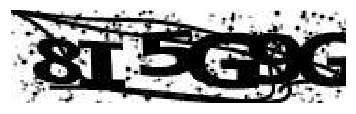

8I5G9G


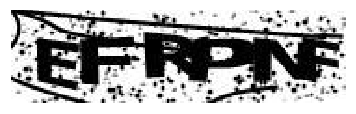

EFRPNF


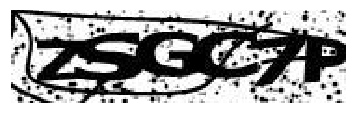

ZSGC7P


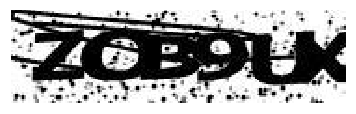

ZOB9UX


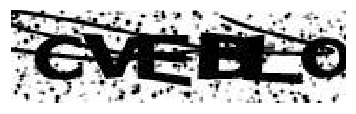

CVEBLO


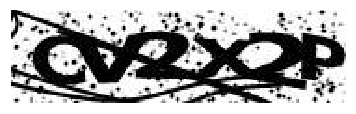

OV2X2P


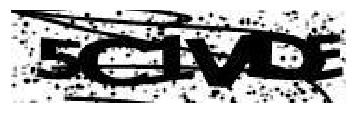

5C1VDE


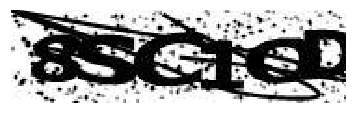

8SC1CD


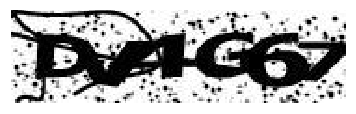

DV4G67


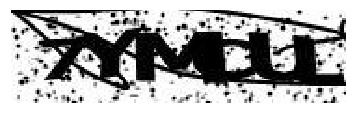

7YMCUL


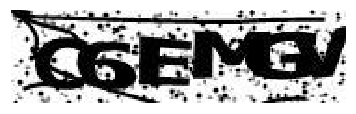

Q6EMGW


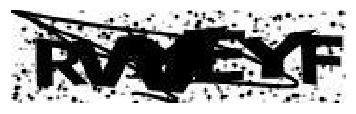

RWKEYF


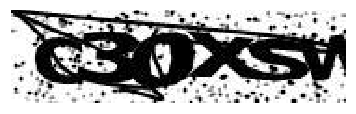

C30XSW


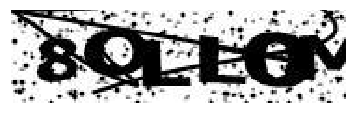

8OLL0M


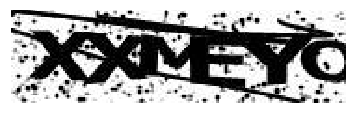

XXMEYO


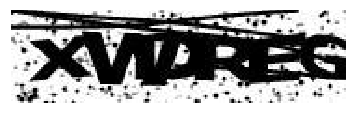

XWDREG


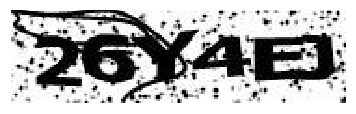

26Y4EJ


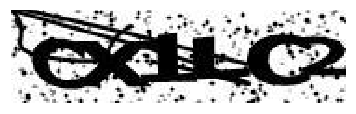

CX1LC2


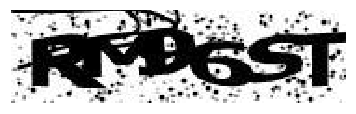

RM96ST


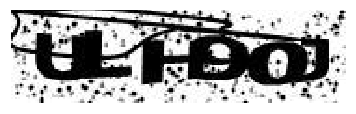

ULH90J


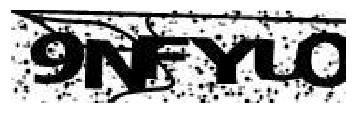

9NFYUO


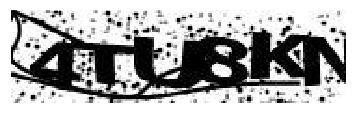

4TU8KN


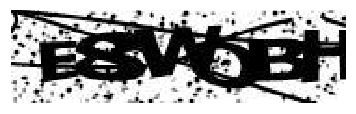

E8WOBH


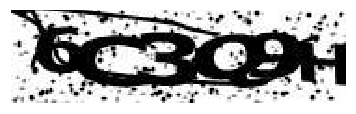

SC3Q9H


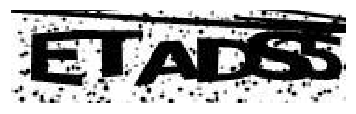

ETADS5


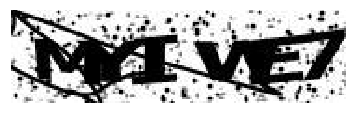

MYIWE7


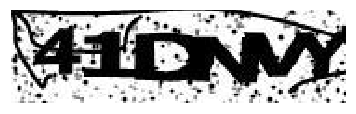

41DNVY


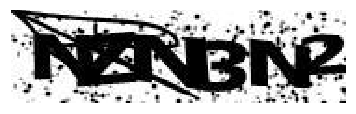

N2NBN2


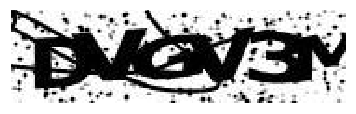

DVGV3M


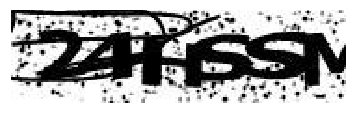

24HSSM


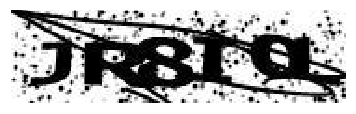

JR8IOL


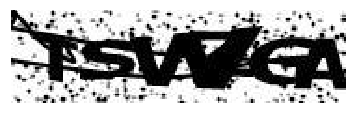

TSW7GA


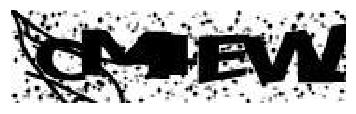

OM4EVW


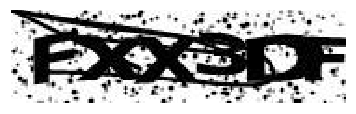

FXX3DF


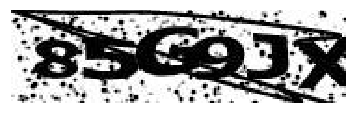

85G9JX


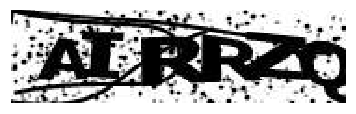

AIRRZO


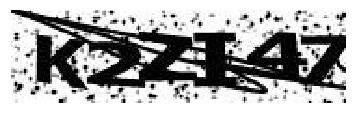

K2ZI47


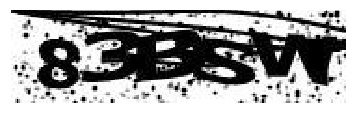

83BSWT


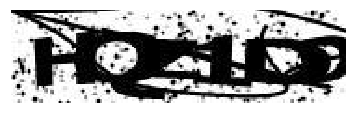

HQZ1DO


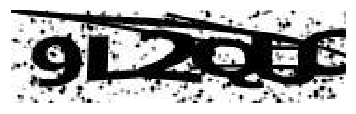

9L2QLC


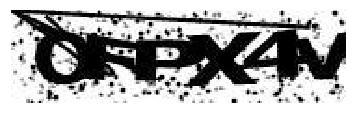

OFPX4V


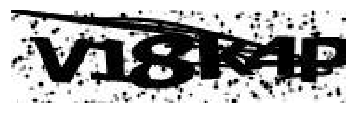

V18K4P


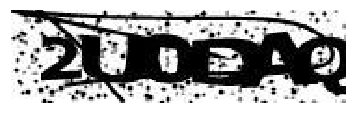

2U0DAQ


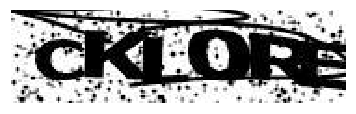

CKL0RE


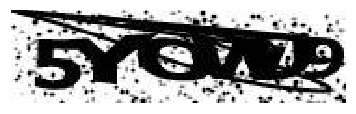

5YOV?9


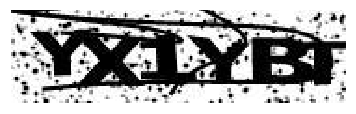

YX1YBT


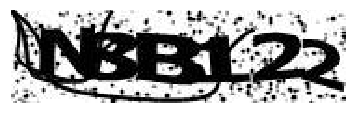

NBB122


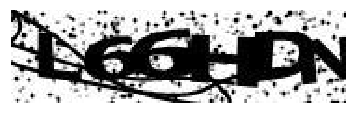

L66HDN


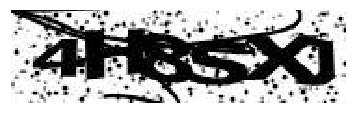

4H8SXJ


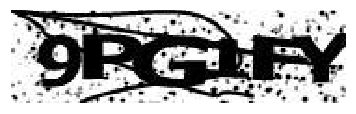

9PG1FY


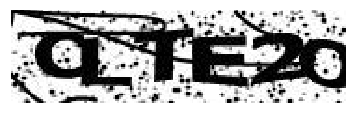

OLTE2O


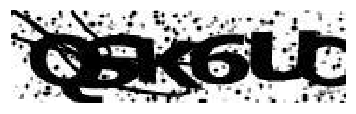

OSK6UC


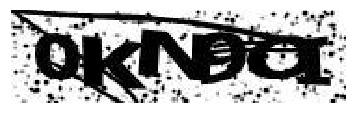

0KN9CI


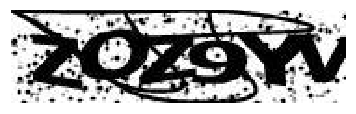

ZOZ9YV


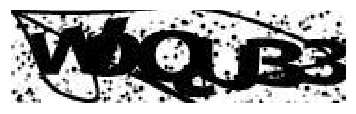

W0QUB3


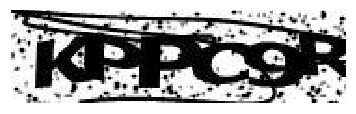

KPPO9R


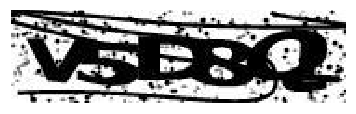

V5D8QL


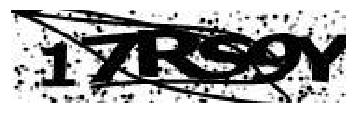

17RS9Y


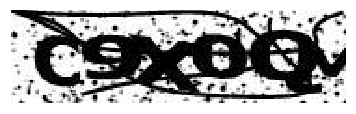

C9X0QM


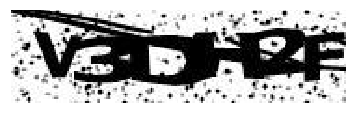

V3DH2F


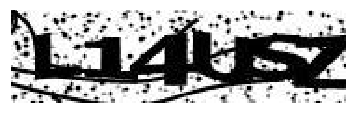

L14USZ


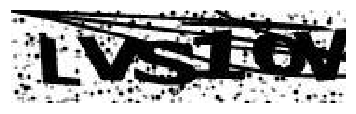

LVS1OV


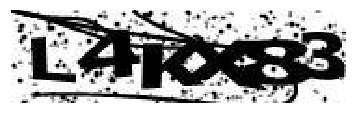

L4KX83


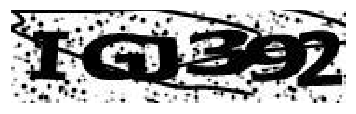

IGJ392


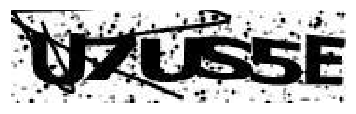

U7US5E


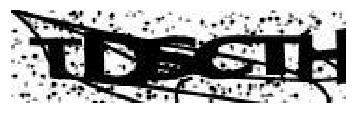

TDSCTH


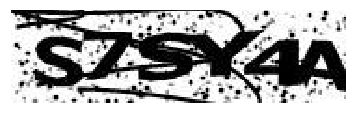

S7SY4A


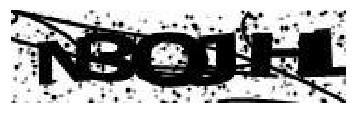

N3OJHL


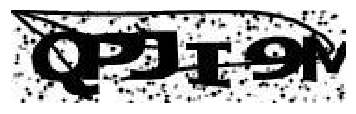

QPJI9M


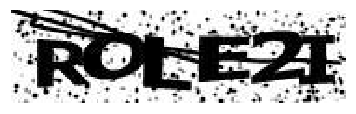

ROLE2I


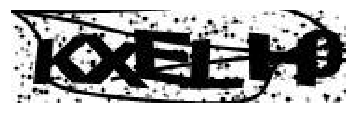

KXELH0


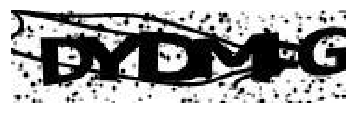

DYDM6G


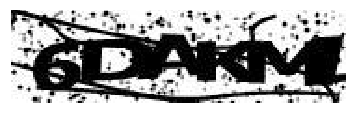

6DAKM1


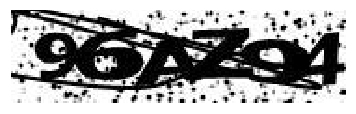

96AZ94


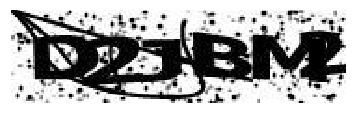

D2JBM2


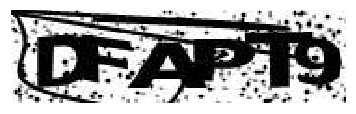

DFAPT9


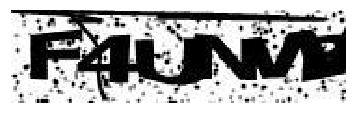

F4UNVB


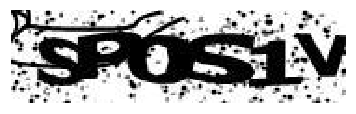

SP0S1V


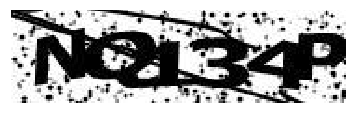

NQ134P


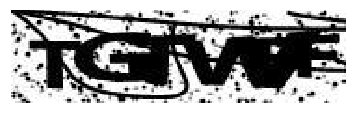

TGTWPF


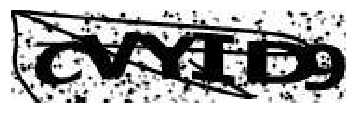

CVYID9


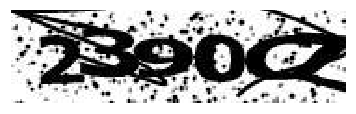

2390CZ


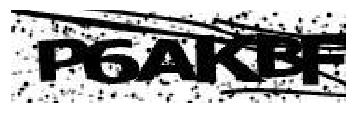

P6AKBF


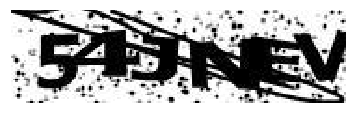

54JNEV


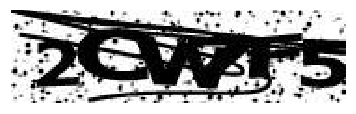

2CW7F5


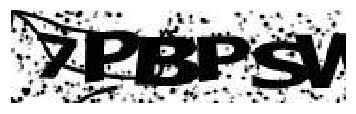

7PBPSW


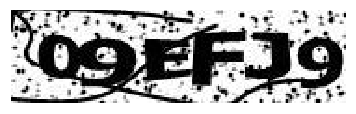

09EFJ9


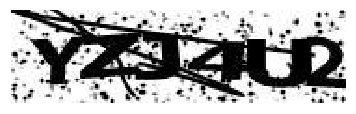

YZJ4U2


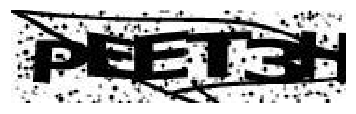

PEET3H


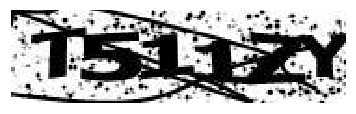

T511ZY


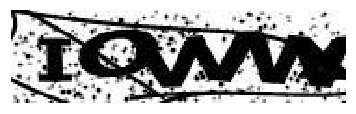

IOVVWX


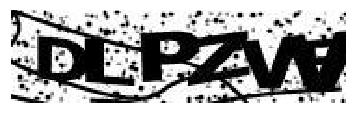

DLPZW?


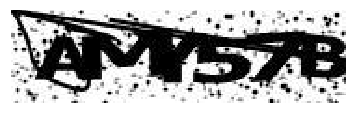

AMY57B


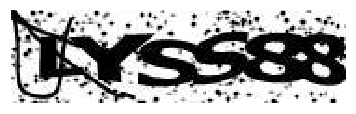

LYSS88


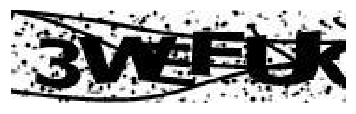

3WEFLK


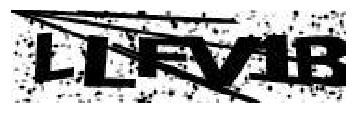

LLFV1B


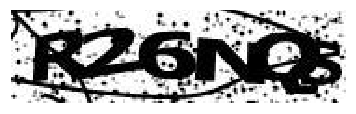

R26NQ5


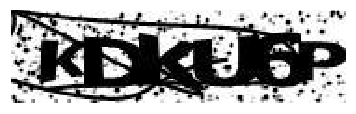

KDKU6P


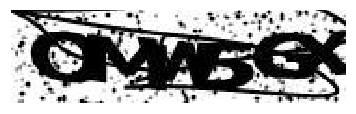

OMW56X


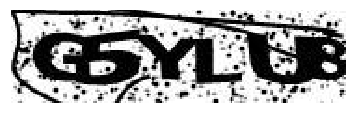

G5YLU8


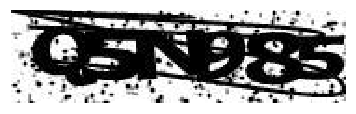

Q5N985


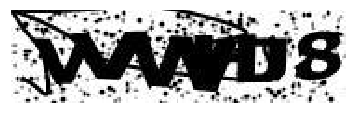

VVWHJ8


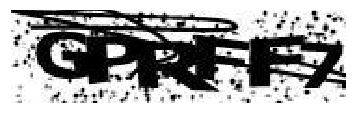

GPRFF7


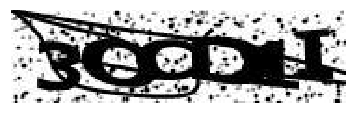

3QCD1I


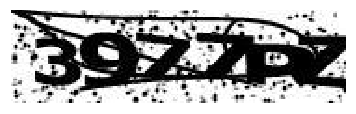

39Z7PZ


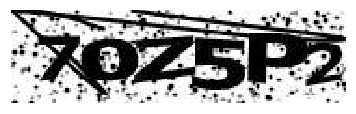

7OZ5P2


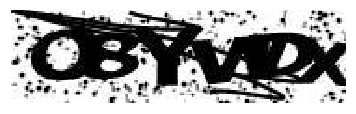

O8YWDX


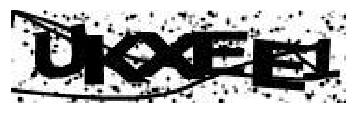

UKXEE1


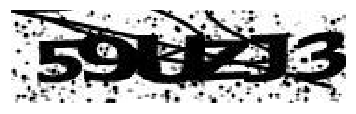

59UZJ3


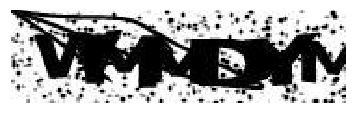

WMMDYM


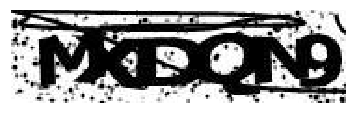

MKDQN9


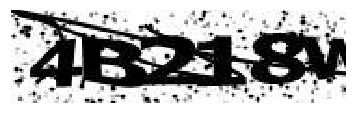

4B218W


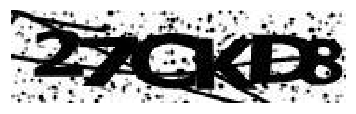

27CKD8


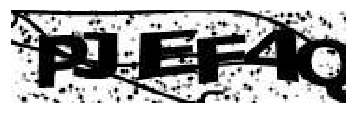

PJEF4Q


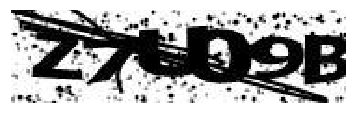

Z7U09B


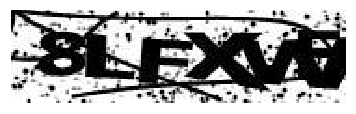

8LFXW5


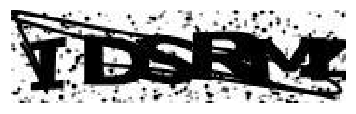

IDSRMZ


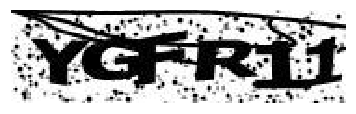

YGFR11


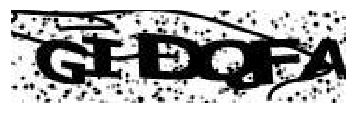

GIDQFA


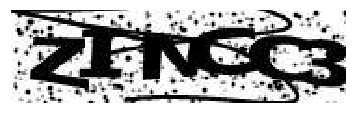

ZINCC3


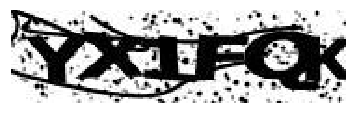

YX1FQK


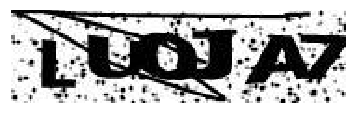

LU0JA7


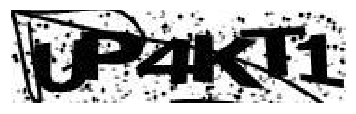

UP4KT1


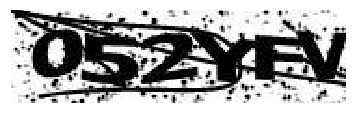

052YFV


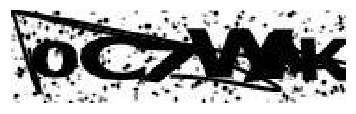

0C7WAK


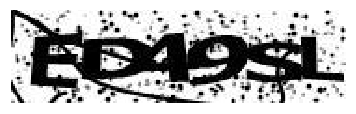

ED49SL


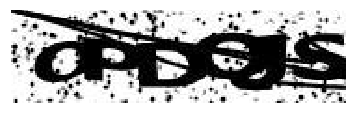

OPDQJS


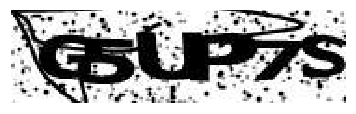

G5UP7S


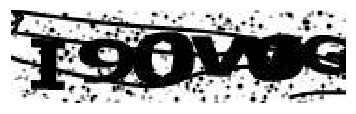

I90WOG


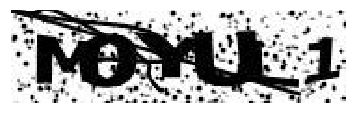

M0YUL1


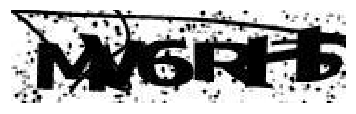

MW6RH5


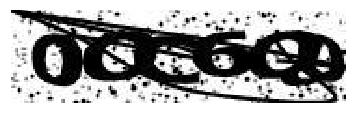

0OC6Q0


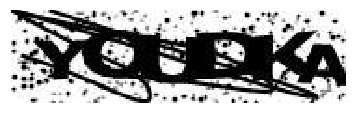

YOUDKA


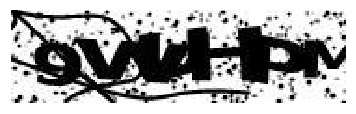

9WWHPM


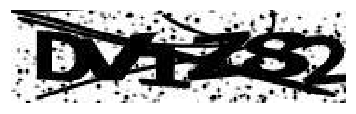

DV1Z82


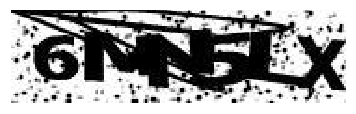

6MM5LX


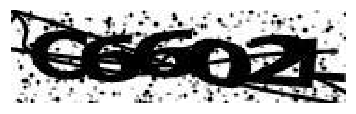

O6602L


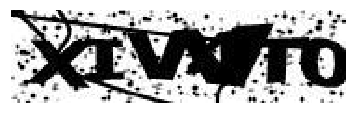

XIW4T0


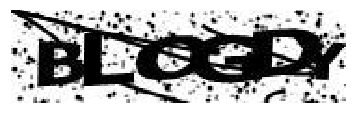

BLCGDY


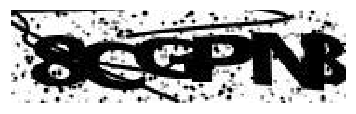

8CGPN8


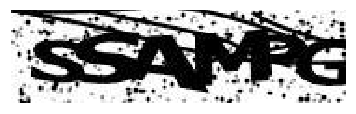

SSAMPG


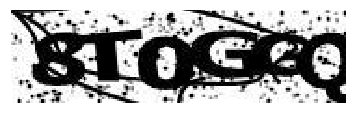

8T0GGO


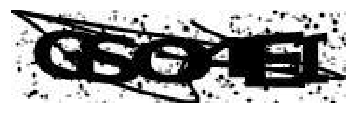

GSO4EI


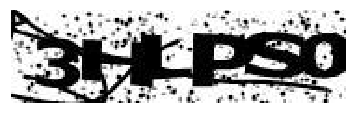

3HLPS0


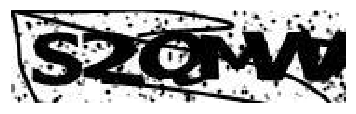

S2QMVV


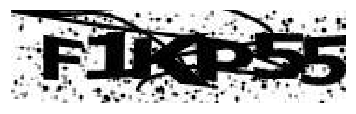

F1KP55


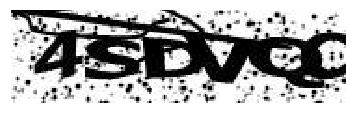

4SDVQO


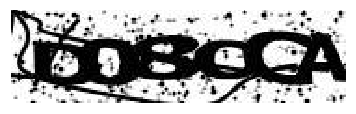

D08OCA


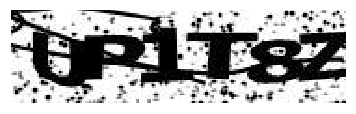

UP1T8Z


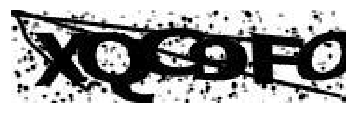

XQC9FO


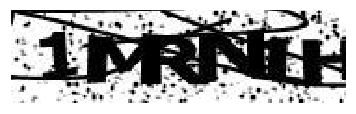

1MRN1H


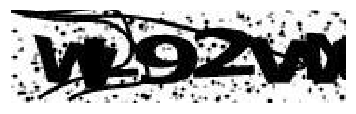

WL92VA


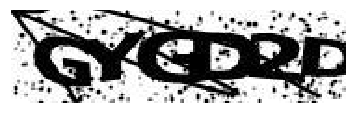

GYGD2D


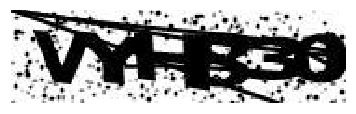

VYHB30


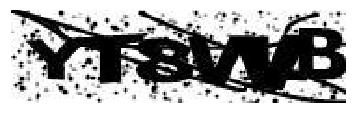

YT8WVB


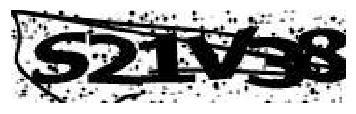

S21V38


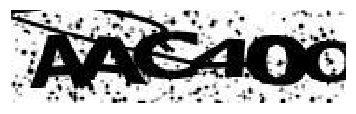

AAC40O


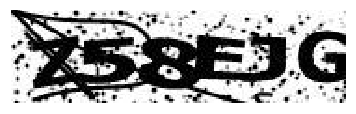

Z58EJG


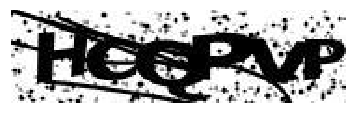

HCQPVP


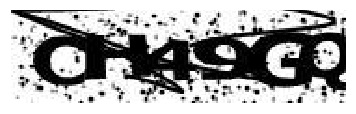

CH49GQ


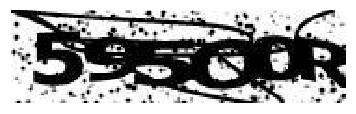

595Q0R


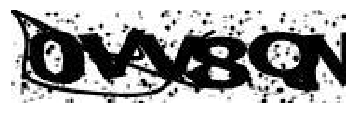

0VV8QN


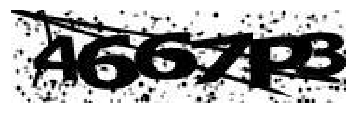

4667P3


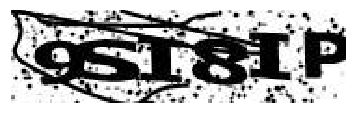

9SI8IP


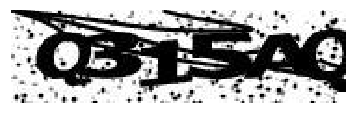

Q315AQ


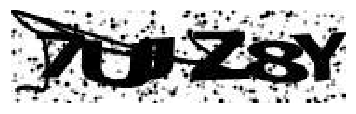

7UJZ8Y


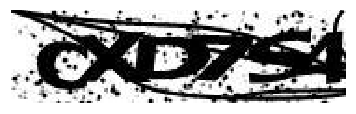

QXD7S4


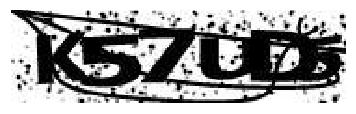

K57UD5


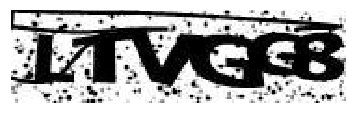

LTVGG8


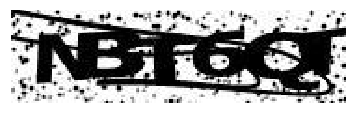

NBI6QT


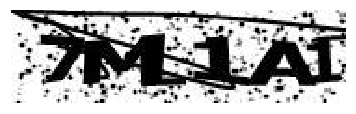

7ML1A1


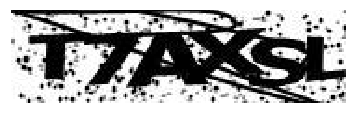

T7AXSL


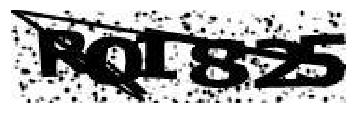

R0I825


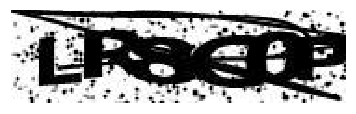

LR8COP


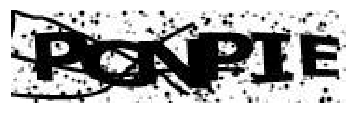

PCNPIE


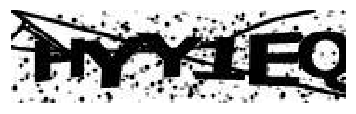

HYY1EQ


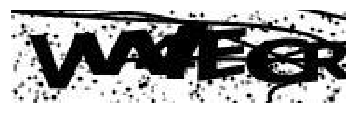

VW4ECR


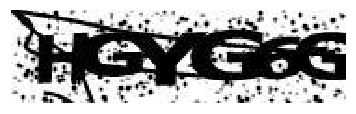

HGYG6G


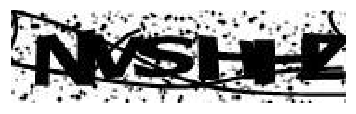

NVSHHZ


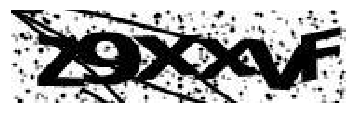

Z9XXVF


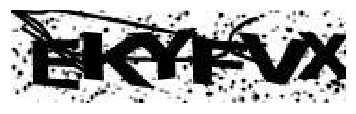

EKYFVX


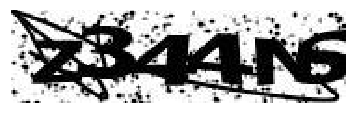

Z344N6


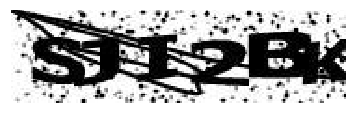

SJI2BK


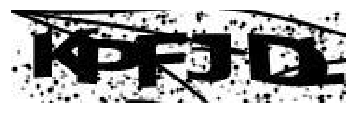

KPFJDL


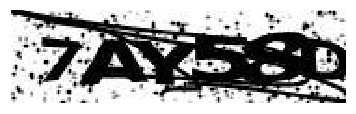

7AY58D


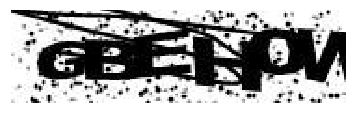

GBEHOW


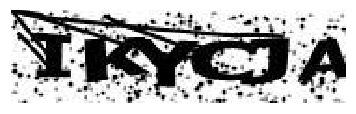

IKYCJA


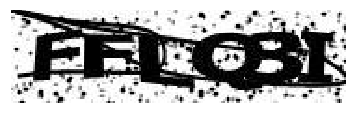

FFLQ3I


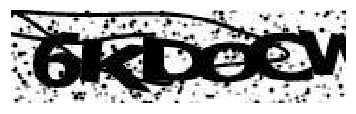

6KDOCW


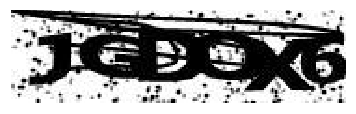

JGDOX6


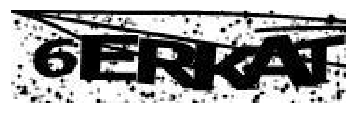

6ERKAT


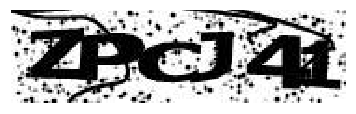

ZPCJ41


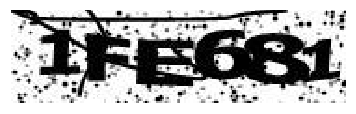

1FE681


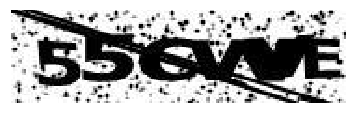

55GWWE


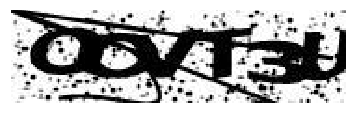

ODVT3U


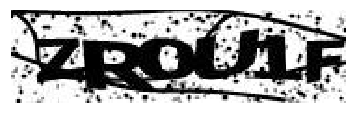

ZR0U1F


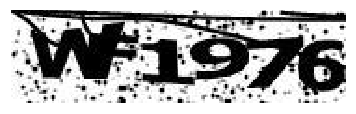

WF1976


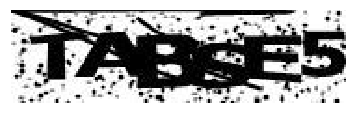

TABSE5


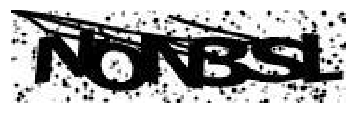

NQNBSL


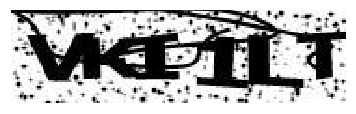

VKI1LT


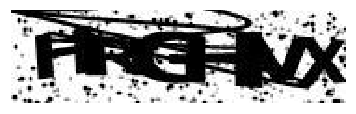

HRGHVX


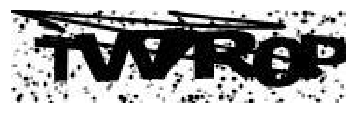

TW7R0P


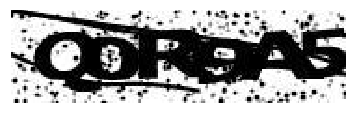

QOR9A5


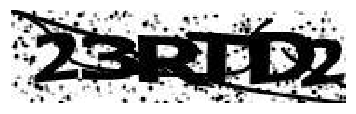

23RJD2


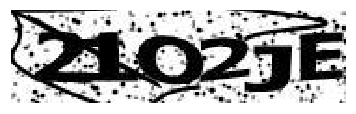

21O25E


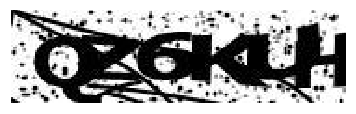

QZ6KLH


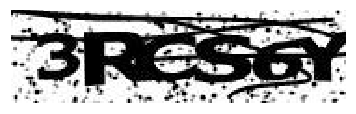

3RCS6Y


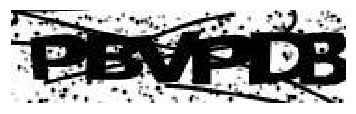

PBVPDB


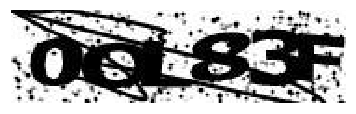

0OL83F


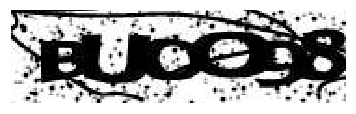

BUOOD8


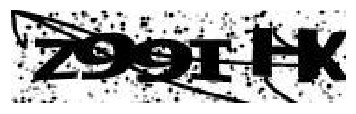

Z99IHK


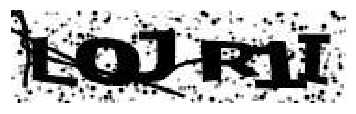

LOJR1I


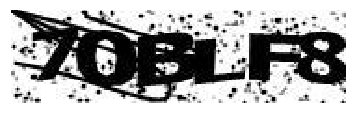

70BLF8


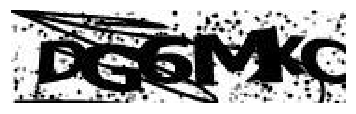

DG6MXC


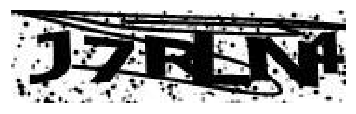

J7RLN4


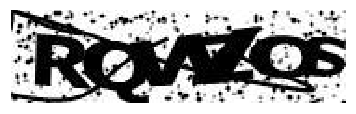

RQWZCS


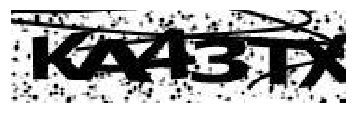

KA43TX


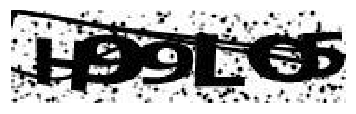

H99LC5


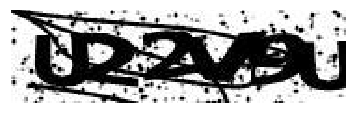

U22V9U


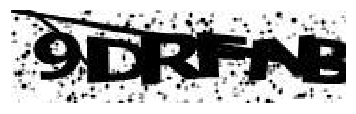

9DRFNB


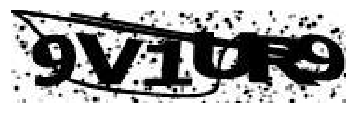

9V1UR9


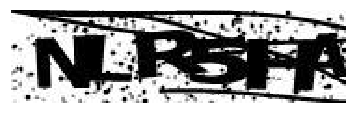

NLR5HA


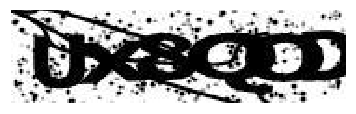

UX8QCD


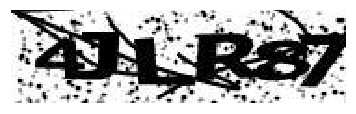

4JLR67


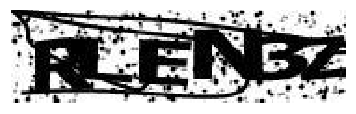

RLENBZ


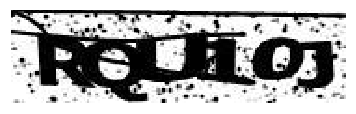

RQU10J


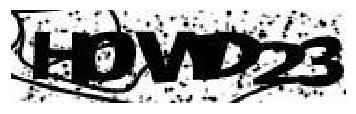

H0WD23


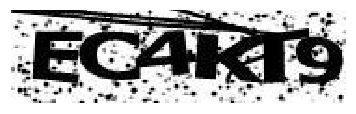

EC4KT9


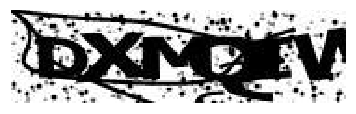

DXMQIW


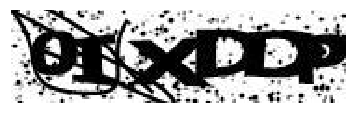

0IXDDP


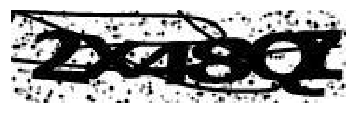

2X48QZ


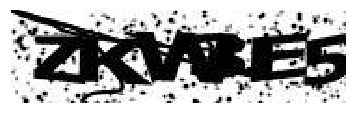

ZKW3E5


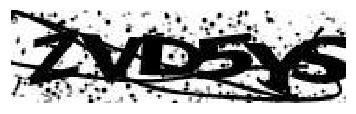

ZVD5YS


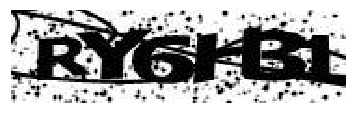

RY6H31


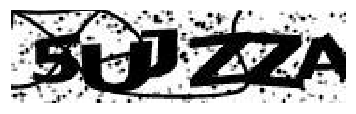

5UJZZA


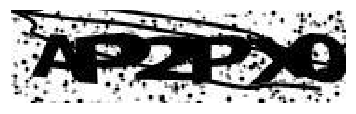

AP2PX0


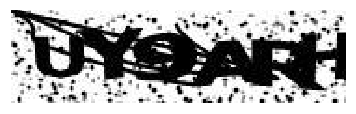

UY9ARH


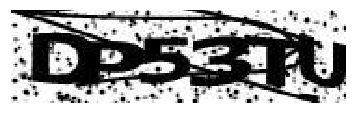

DP53TU


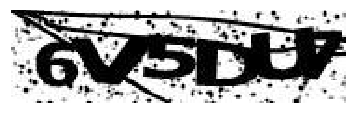

6V5DU7


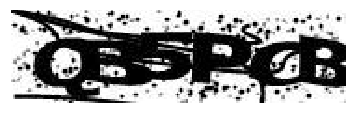

QB5PCB


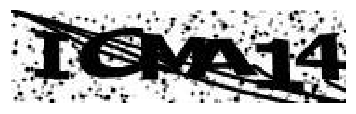

ICMA14


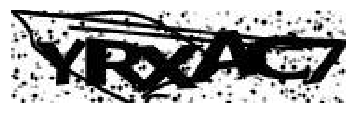

YRXAC7


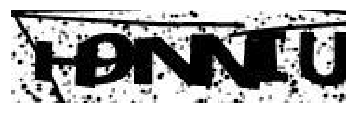

H9NNIU


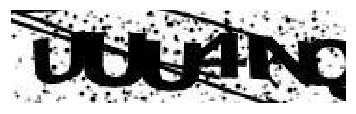

UUU4NQ


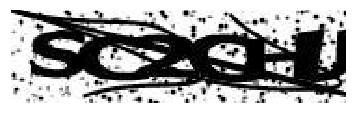

SC2CHU


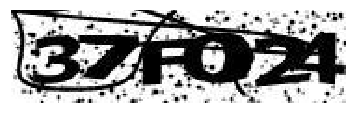

37FO24


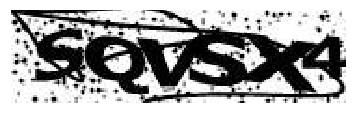

SQVSX4


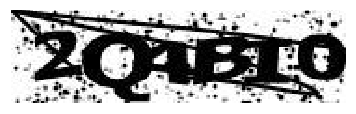

2O4BI0


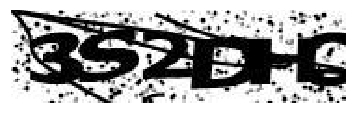

3S2DHC


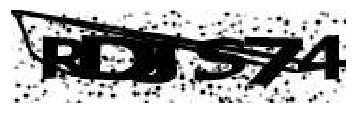

RDJS74


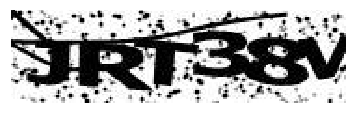

JRT38V


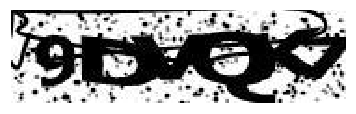

9DVQK7


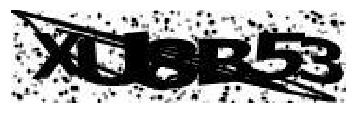

XU8B53


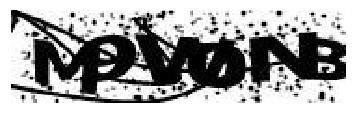

M9WONB


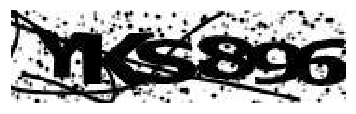

YKS896


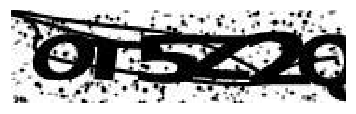

OT5Z2O


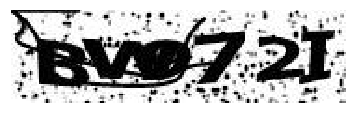

BW?72I


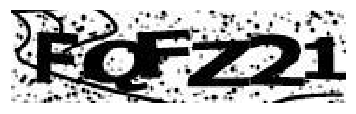

FQFZ21


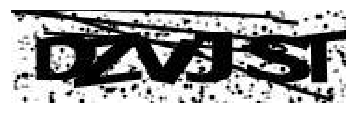

DZVJST


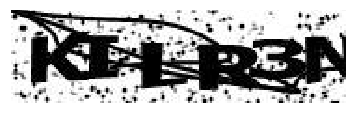

KILR3N


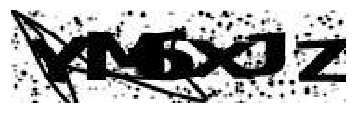

YM6XJZ


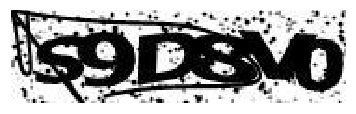

S9D8V0


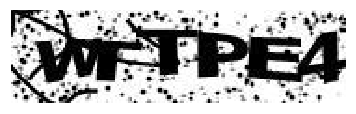

WTTPE4


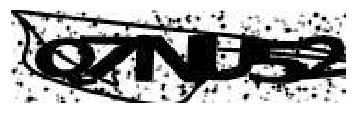

Q7NU52


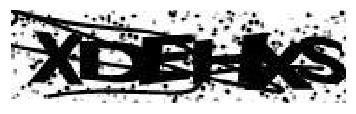

XDEHXS


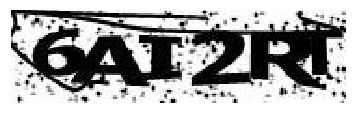

6AI2RT


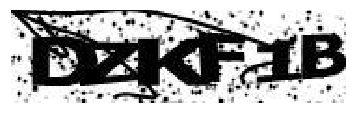

DZKF1B


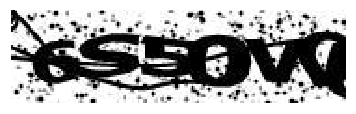

6S50W0


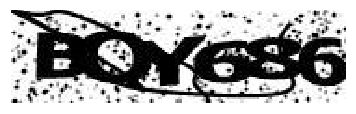

BOY686


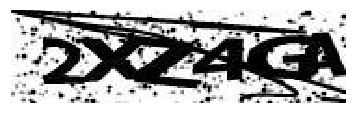

2XZ4GA


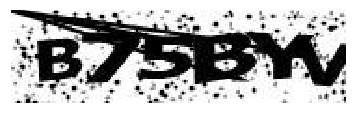

B75BYV


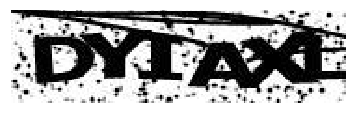

DYIAXL


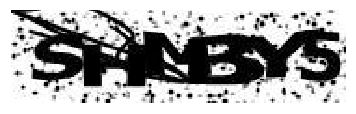

SHMBY5


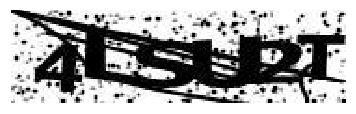

4LSU2T


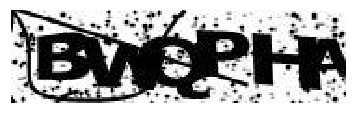

BWQPHA


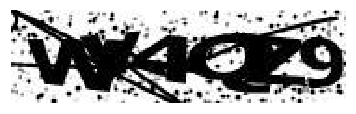

WX4QZ9


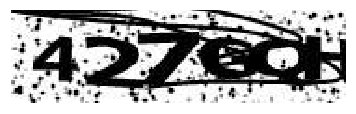

427GQH


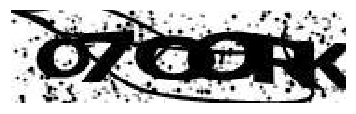

O7OORK


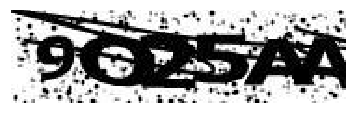

9Q25AA


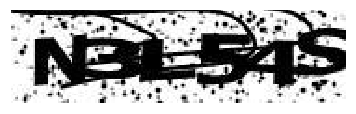

N3L54S


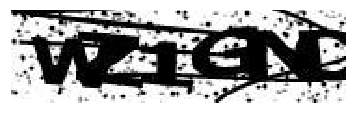

WZ1GND


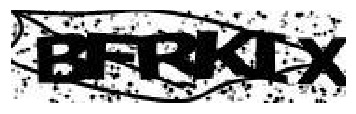

BFRKIX


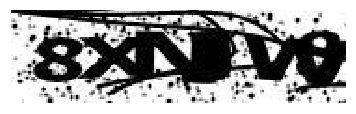

8XNJW8


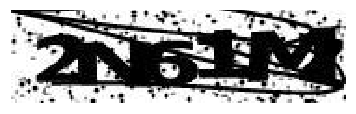

2N61MX


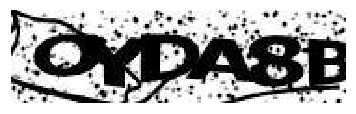

OYDA8B


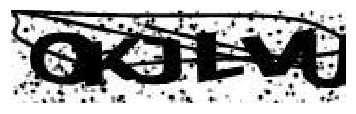

OKJLVU


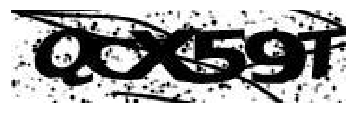

QOX59T


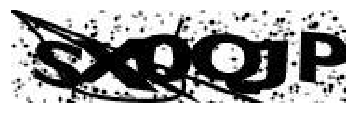

SX0QJP


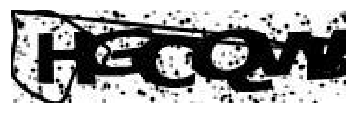

HGCQWB


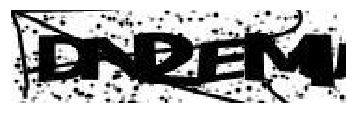

DN2EMU


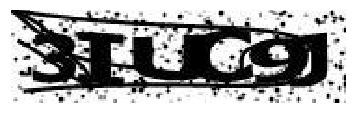

3IUO9J


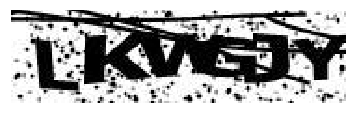

LKWGJY


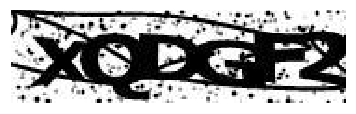

XODGF2


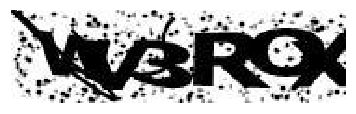

WV3RCX


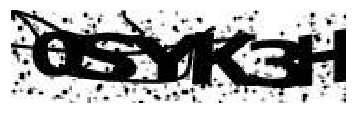

0SYK3H


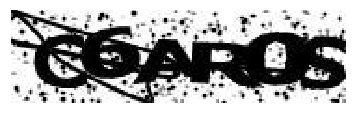

C6AR0S


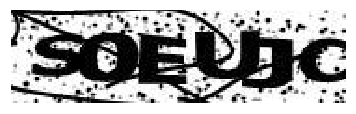

S0EUJC


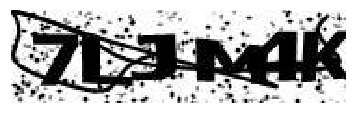

7LJM4K


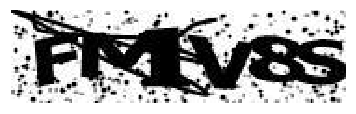

FM1V8S


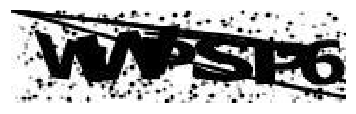

WWPSP6


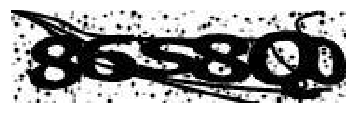

86S8O0


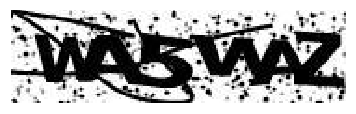

WA5WAZ


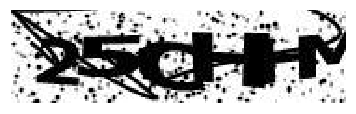

25CHHM


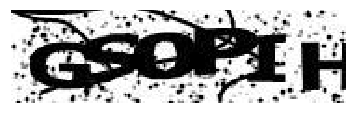

GS0HIH


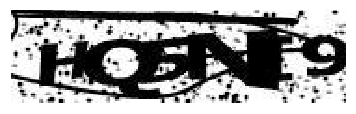

HQ5NI9


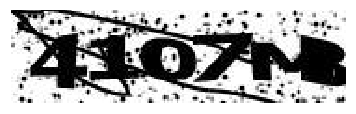

4107MB


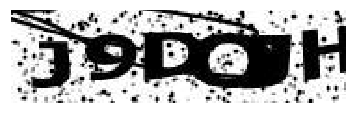

J9DQJH


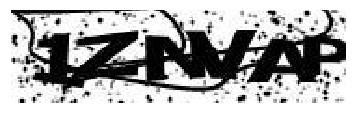

1ZNVAP


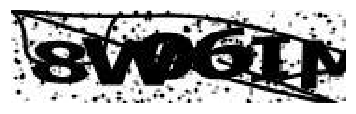

8W06IM


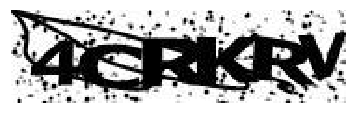

4ORKRV


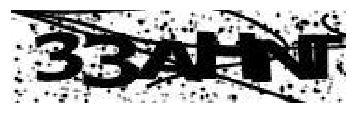

33AHNT


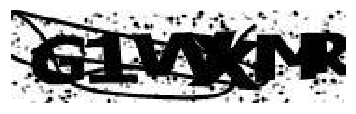

G1WXNR


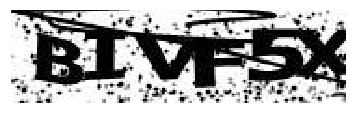

BIVF5X


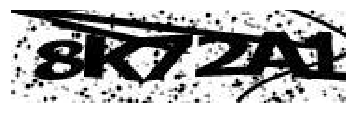

8K72A1


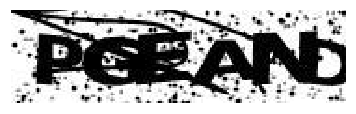

PGEAND


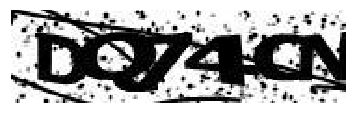

DQ74?N


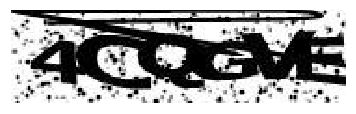

4CQGVE


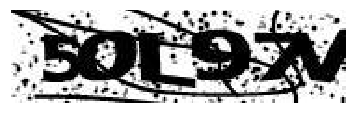

50L97V


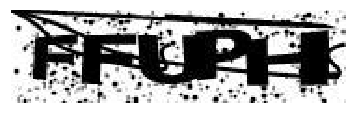

FFUPH1


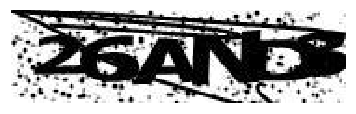

26AND8


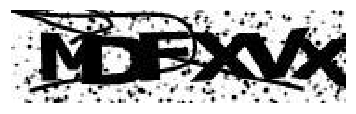

MDFXVX


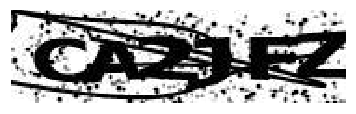

CA2JFZ


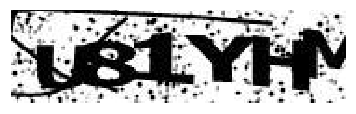

U81YHM


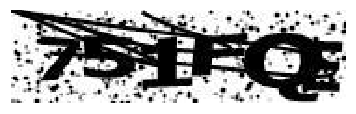

751FCF


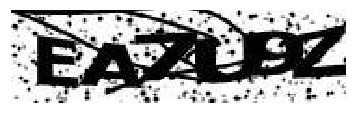

EA7U9Z


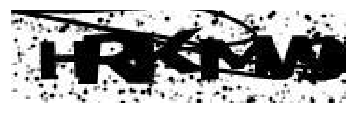

HRKMV9


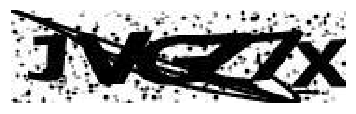

JVGZ7X


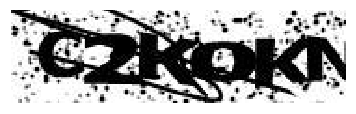

C2K0KN


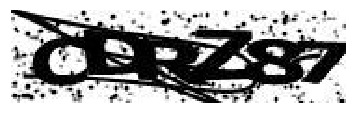

CDRZ87


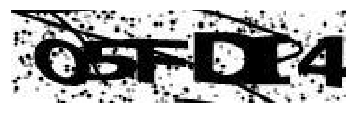

O5FDI4


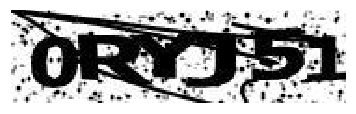

0RYJ51


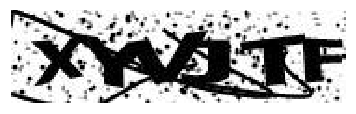

XYVJTF


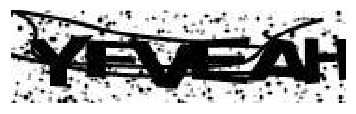

YFVEAH


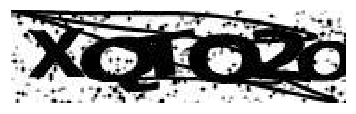

XQTO2O


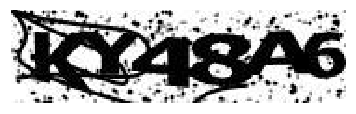

KY48A6


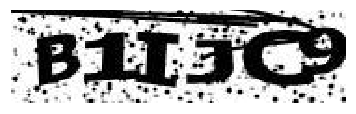

B1IJC9


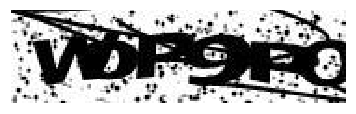

WOP9PO


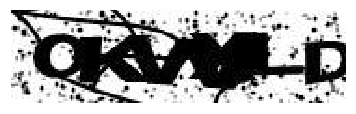

OKWXLD


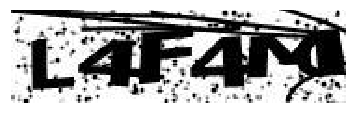

L4F4M0


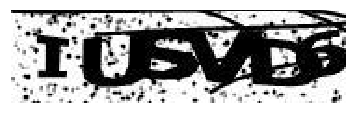

IUSVD6


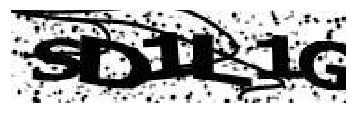

SD1L1G


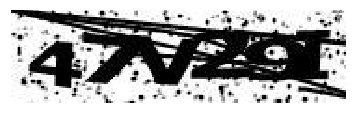

47V29I


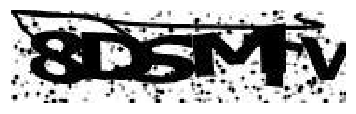

8DSMTV


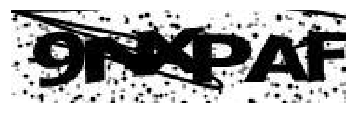

9NXPAF


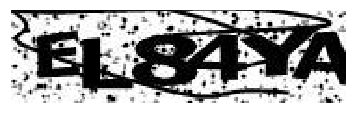

EL84YA


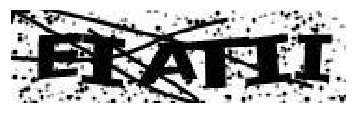

EIATII


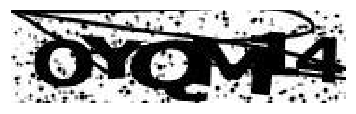

QYQM14


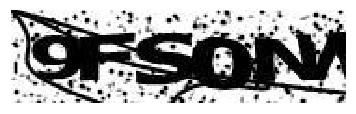

9FS0NW


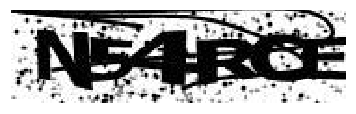

N54RCE


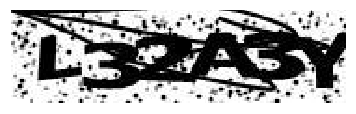

L32A3Y


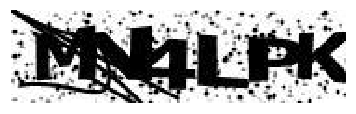

MN4LPK


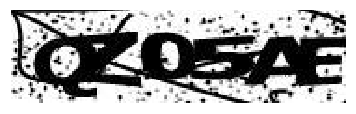

QZ05AE


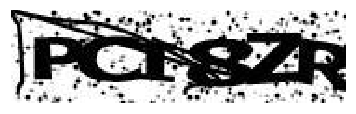

PCI8ZR


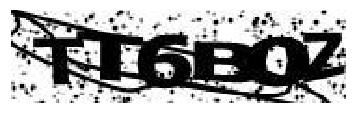

TT6BQZ


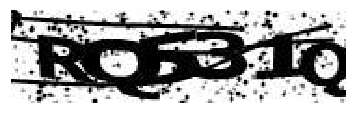

RQ531Q


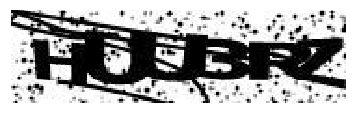

HUU3RZ


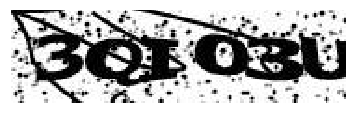

3QI03U


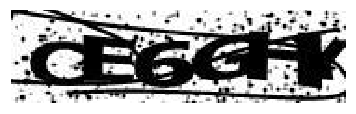

CE6GHY


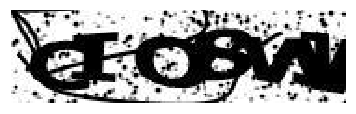

QIQ8WJ


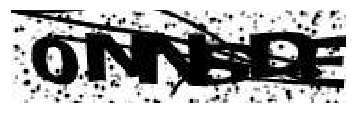

0NNSDE


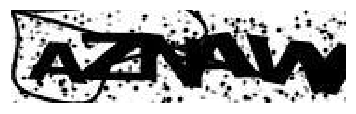

AZNAWV


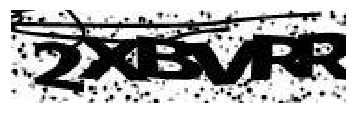

2XBVRR


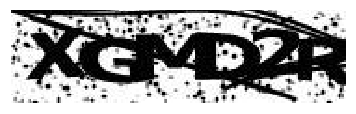

XGMD2R


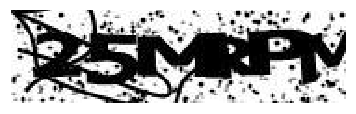

25MRPM


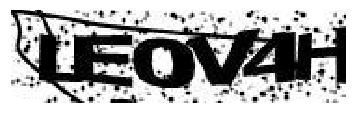

UE0V4H


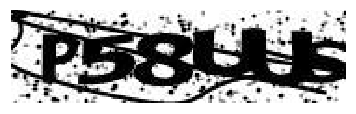

P58UUS


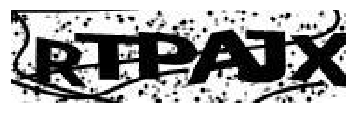

RTPAJX


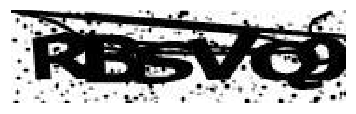

RBSVQ9


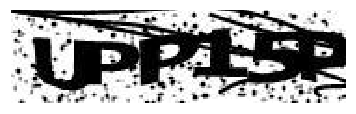

UPP15P


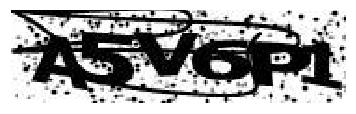

A5V6P1


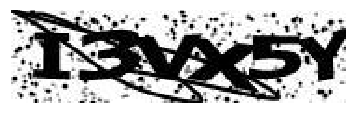

I3VX5Y


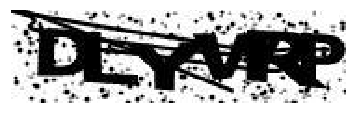

DLYVRP


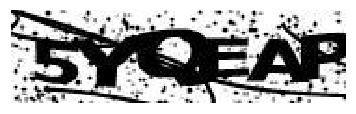

5YQEAP


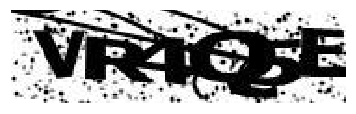

VR4Q5E


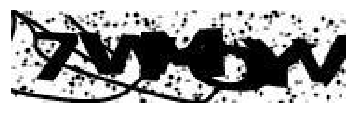

7WMOYV


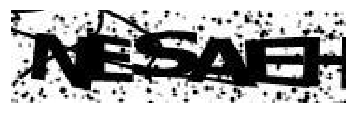

NESAEH


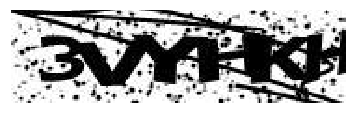

3VYHKH


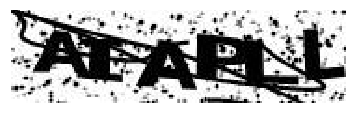

AIAPLL


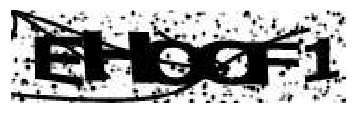

EHOOF1


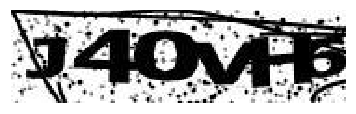

J40VH6


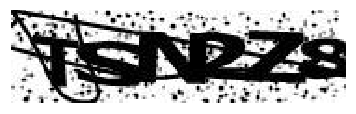

TSN2Z8


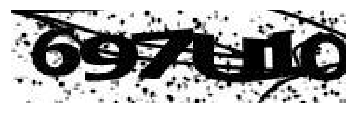

697U1O


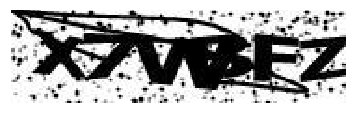

X7WBFZ


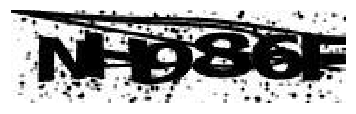

NH986F


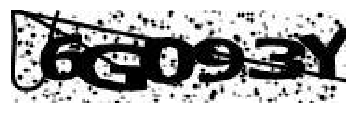

6G093Y


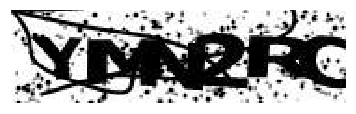

YMN2RC


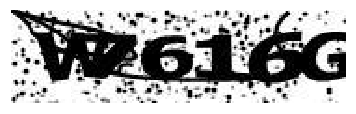

W7616G


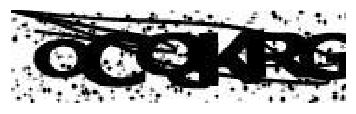

OCQKRG


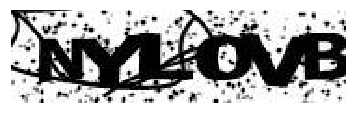

NYL0VB


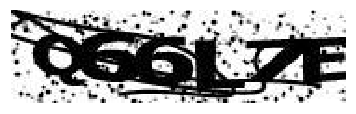

Q66L7E


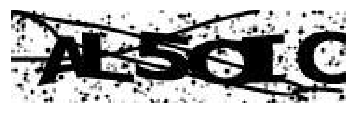

AL5QIC


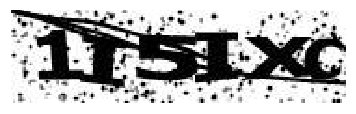

1I5IXO


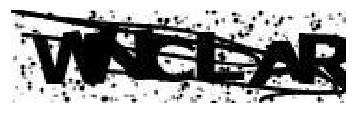

WNCLAR


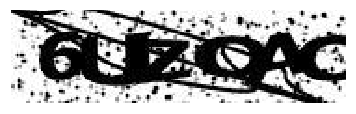

6UZCAC


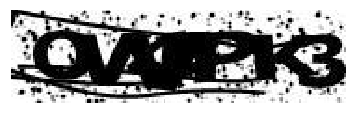

OW4PK3


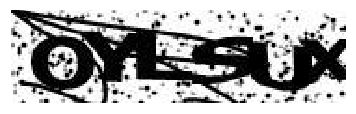

OYLSUX


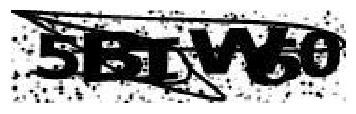

5BIW60


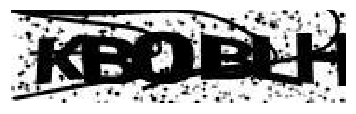

KB0BLH


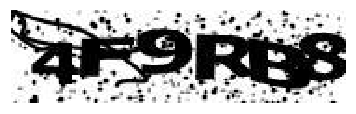

4F9RB8


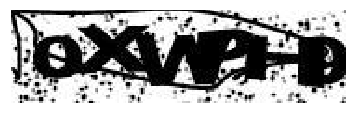

0XWPH9


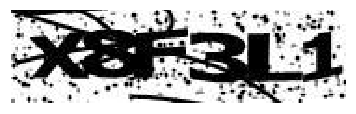

X8F3L1


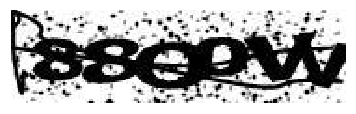

88Q0VV


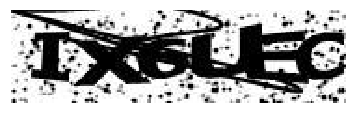

IX6UEC


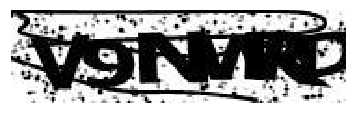

V9NWRD


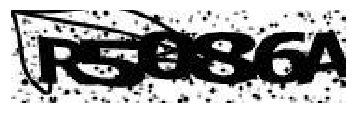

R5086A


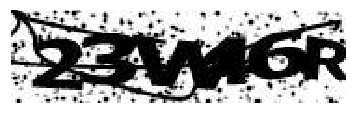

23W46R


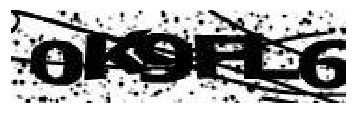

0K9FL6


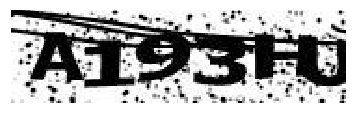

A193HU


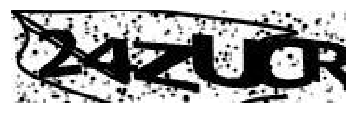

24ZUQR


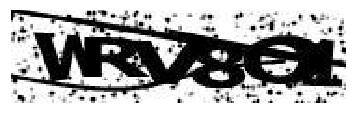

WRV8G1


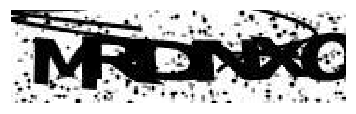

MRDNXO


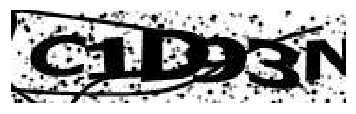

C1D93N


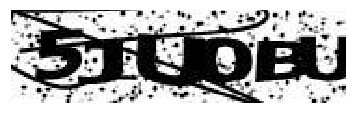

5JUOBU


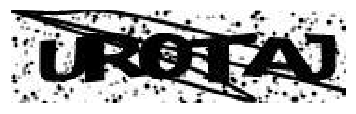

UR0TAJ


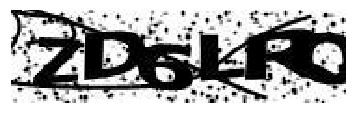

ZD6LRO


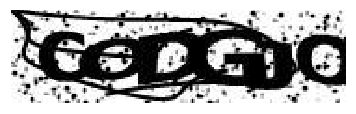

CODGJO


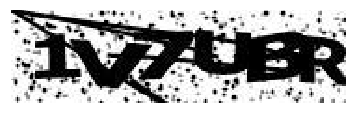

1V7UBR


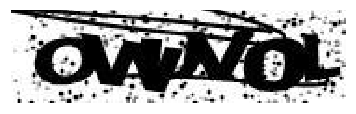

OWUV0L


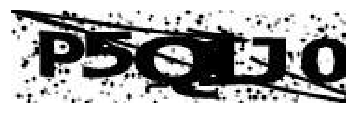

P5Q1J0


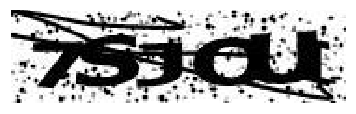

7SJOUI


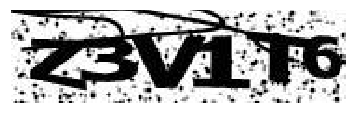

Z3V1T6


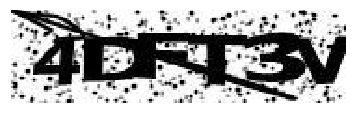

4DFT3V


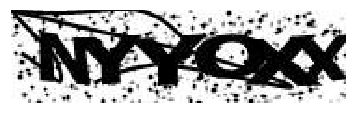

NYYCXX


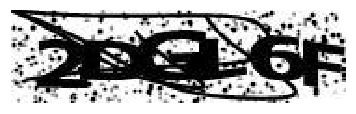

2DGL6F


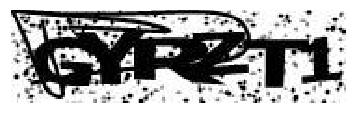

GYRZT1


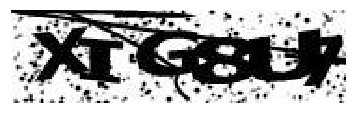

XIG8U7


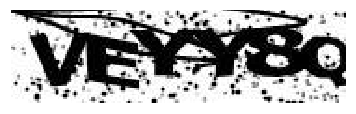

VEYY8Q


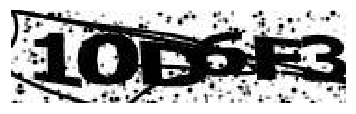

1OD6F3


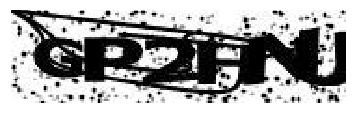

GP2HNU


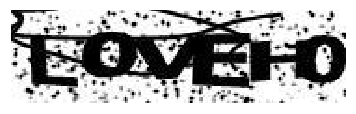

L0VEH0


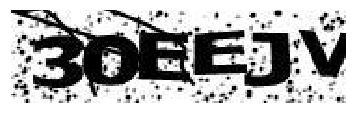

30EEJV


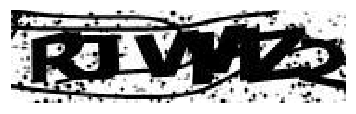

RJWWZ2


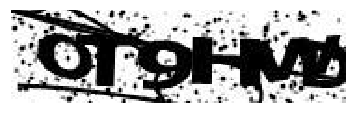

OT9HWD


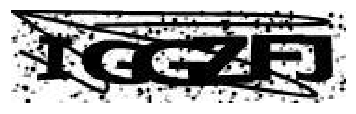

IGGZFJ


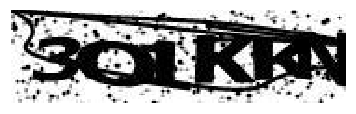

3Q1KKN


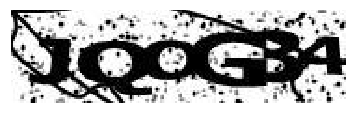

JQOGB4


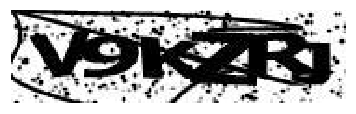

V9KZRJ


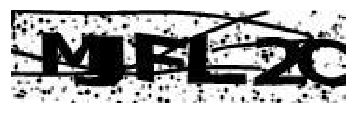

MJFL2Q


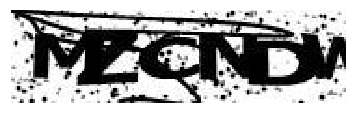

MZCNDW


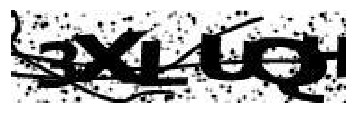

3XLUQH


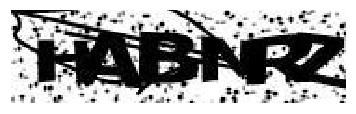

HABNRZ


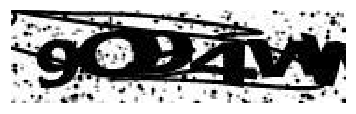

9O94WW


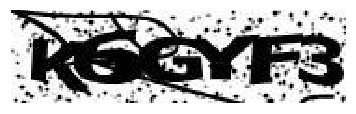

K6GYF3


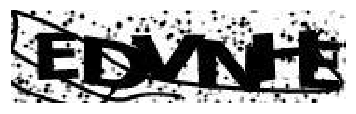

EDVNHE


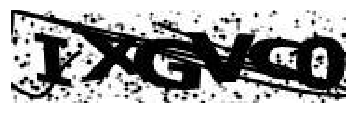

IXGVC0


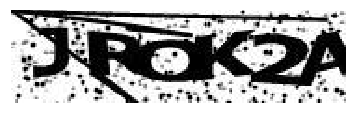

JROK2A


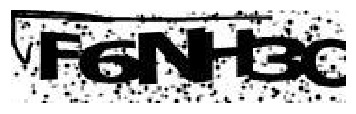

F6NH3Q


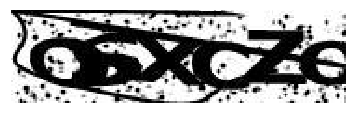

Q6XOZO


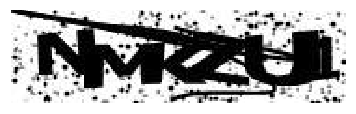

NMRZU1


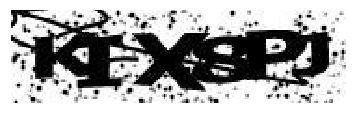

KIX8PJ


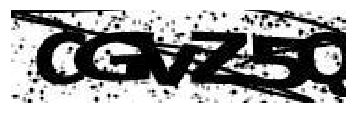

CGVZ5Q


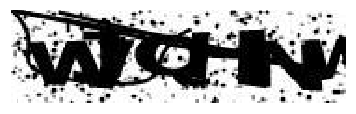

WTQHNW


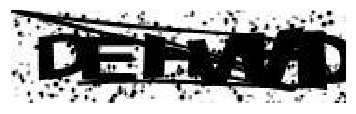

DEHWWD


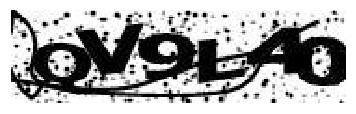

QV9L40


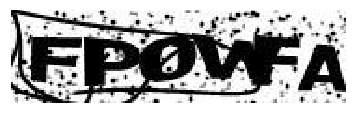

FP0VFA


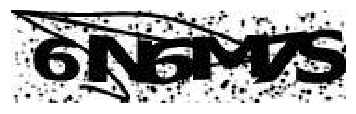

6N6M7S


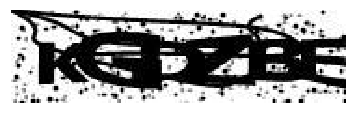

KGDZBE


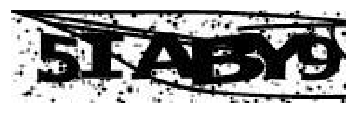

5IABY9


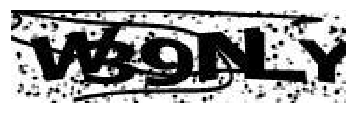

W39NLY


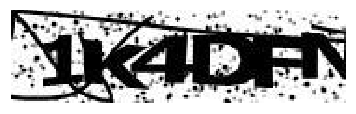

1K4DFN


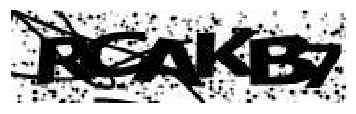

RCAKB7


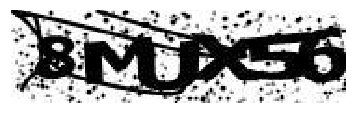

8MUX56


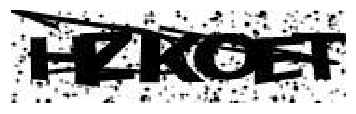

HZKOET


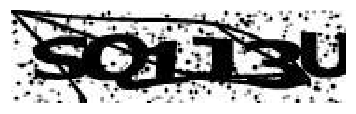

SQ1J3U


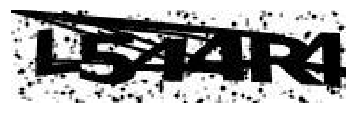

L544R4


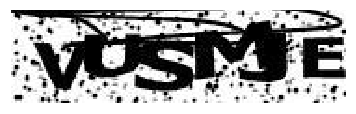

VUSMJE


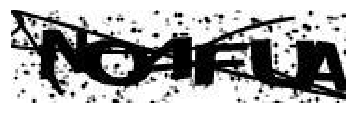

NQ4FUA


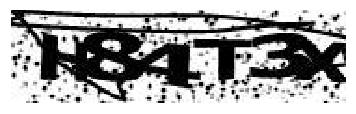

H84T3X


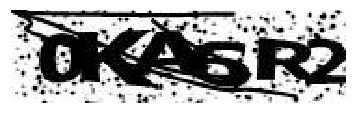

0KA6R2


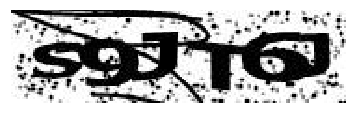

S9JT6J


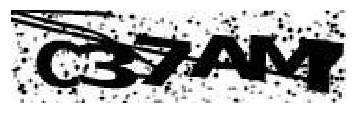

C37AMT


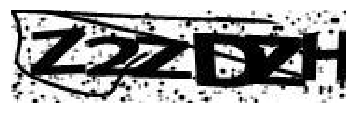

Z2ZDZH


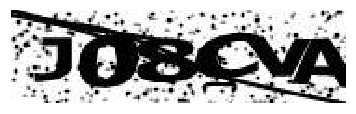

J08CVA


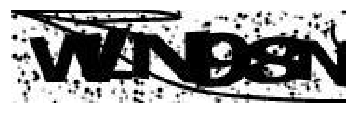

WLN98N


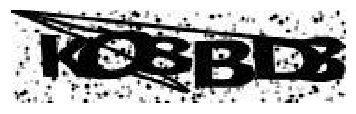

KO8BD3


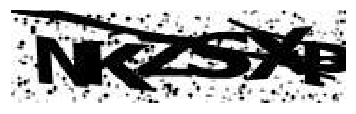

NKZSXP


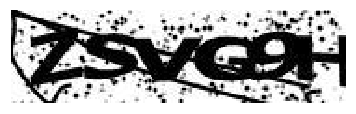

ZSVG9H


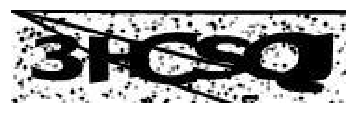

3HCSQJ


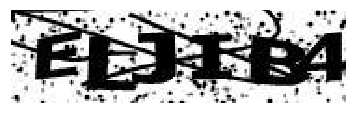

ELJIB4


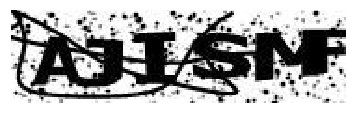

AJISNF


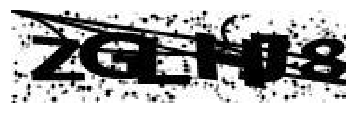

ZGLFJ8


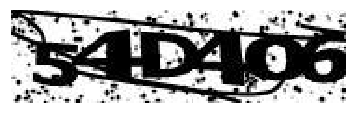

54D4O6


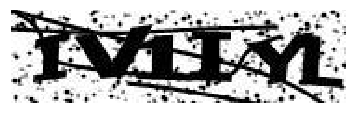

IV1IYL


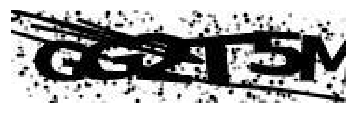

GG2T5M


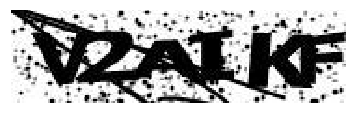

V2AIKF


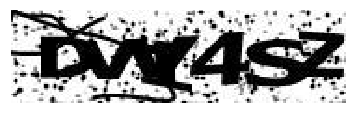

DWY4SZ


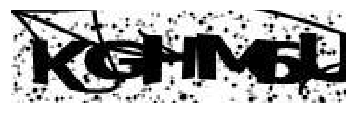

KGHM6U


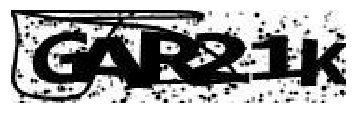

GAR21K


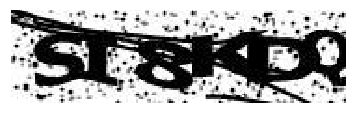

SI8KDQ


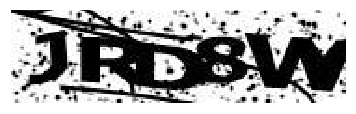

JRD8WW


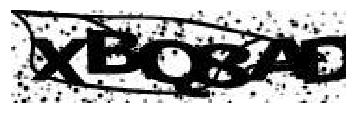

XBQ8AD


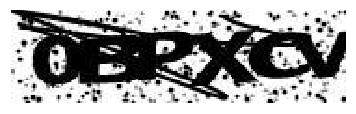

0BPXCV


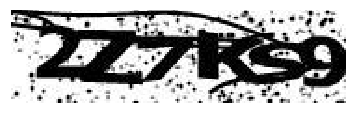

2Z7KS9


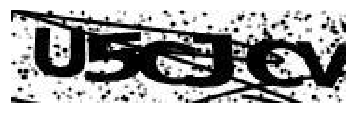

U5OJQV


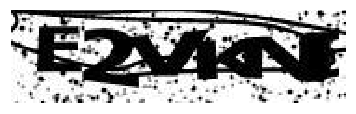

E2VKNI


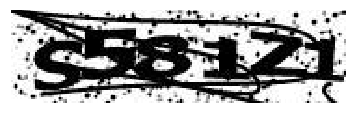

S581Z1


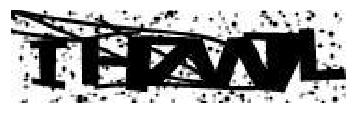

IH7WJL


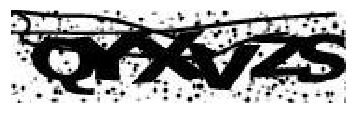

QYXVZS


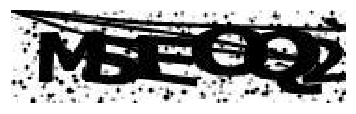

M5ECQ2


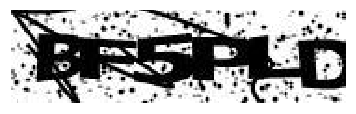

BF5PLD


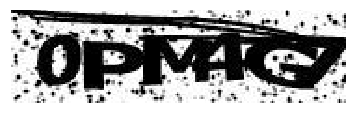

0PM4G7


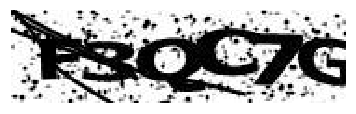

F3QC7G


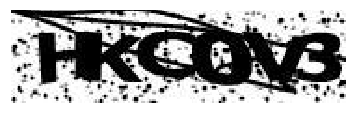

HKC0V3


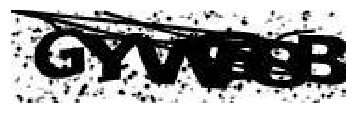

GYWC8B


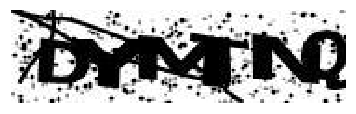

DYMTNQ


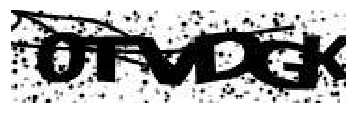

0TVDGK


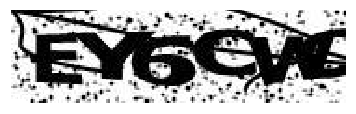

EY6CWO


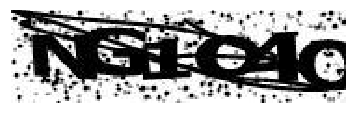

NG1C4Q


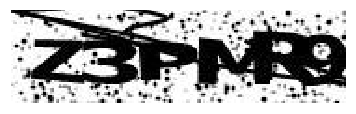

Z3PMR9


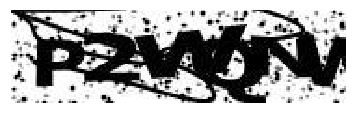

P2WONW


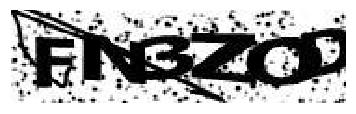

FN3ZOD


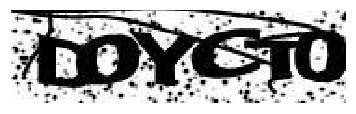

DOYCT0


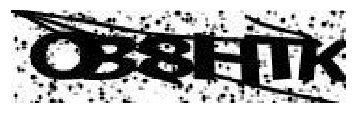

O38HTK


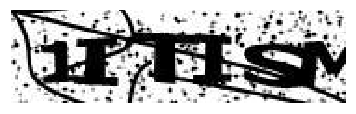

1ITISM


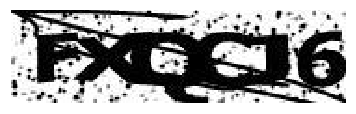

FXQQJ6


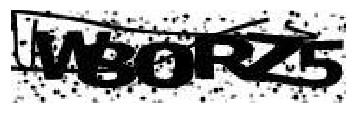

WB0RZ5


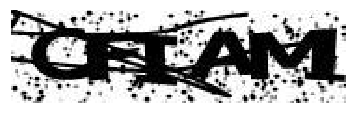

CFIAM1


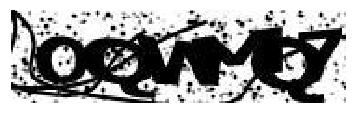

OQWMC7


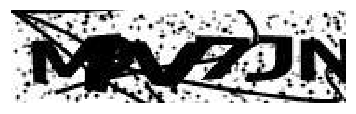

M?V7JN


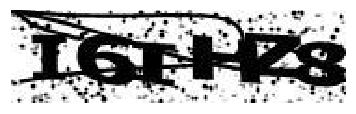

I6IHZ8


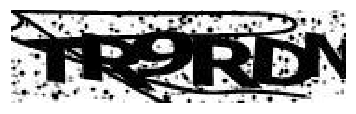

TR9RDN


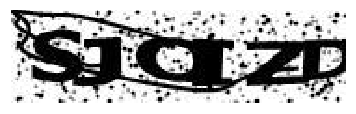

SJCIZD


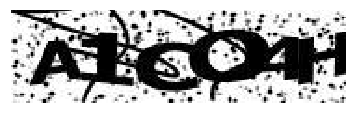

A1OO4H


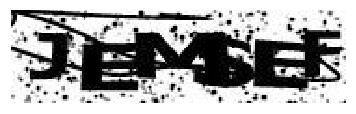

JEMSEF


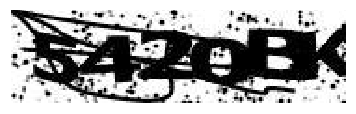

542QBK


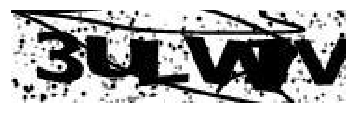

3ULWIV


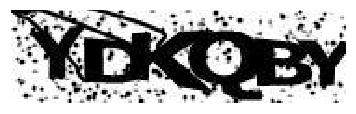

YDKQBY


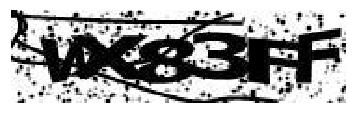

WX83FF


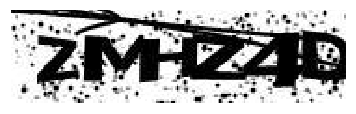

ZMHZ4D


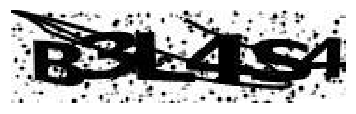

B3L4S4


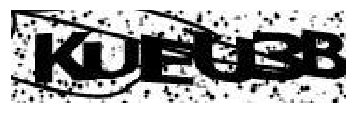

KUEU3B


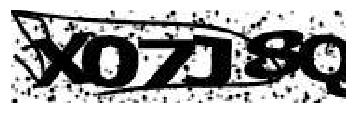

X07J8Q


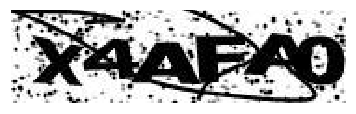

X4AFA0


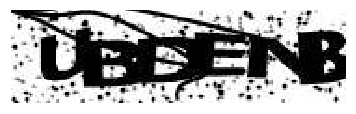

UBDENB


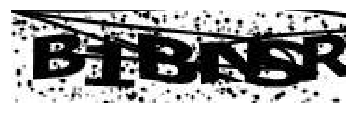

B1BNSR


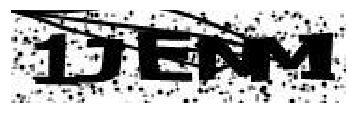

1JENM1


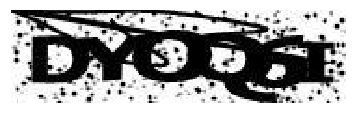

DYOQ6I


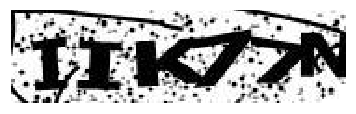

IIK77N


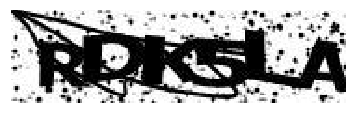

RDK5LA


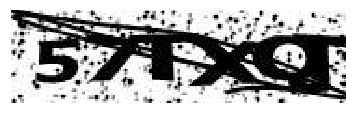

57TXQT


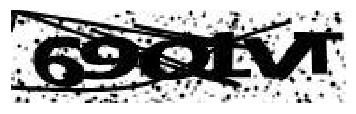

69O1VT


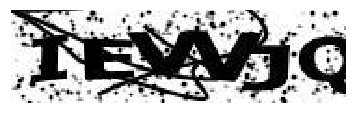

IEVV1Q


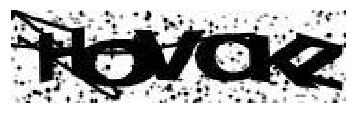

HOVCKZ


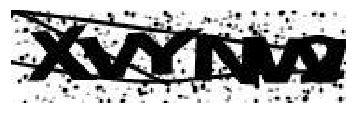

XVYNV2


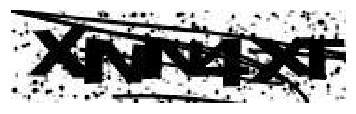

XNN4XT


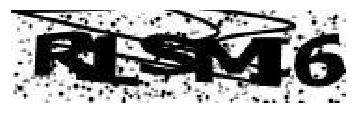

R1SMI6


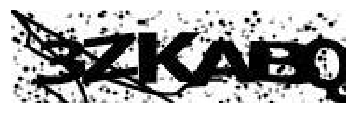

3ZKABO


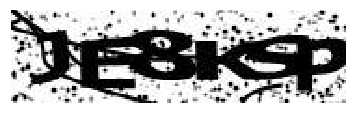

JE8KSP


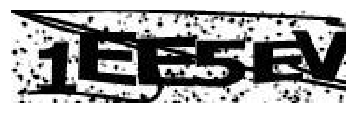

1EE5EW


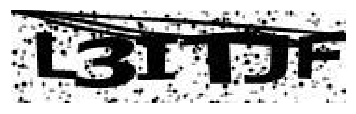

L3ITJF


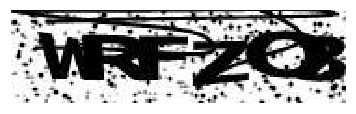

WRFZO3


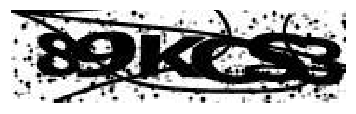

89KCS3


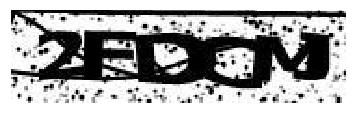

2FDCMJ


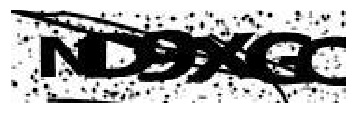

ND9XGC


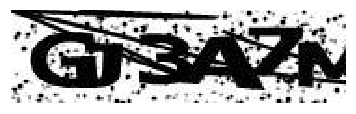

GJ3A7M


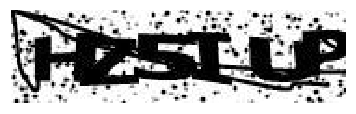

HZ5IUP


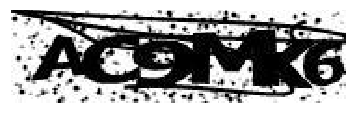

AC9MK6


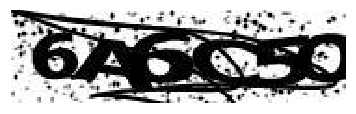

6A6C5O


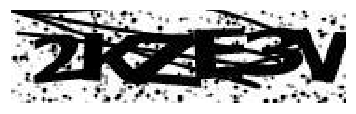

2KZE3V


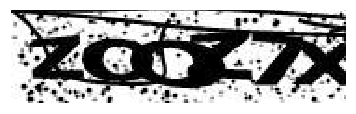

ZOQZ7X


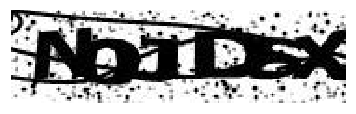

NOJDSX


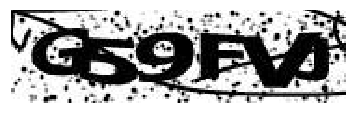

G59FVJ


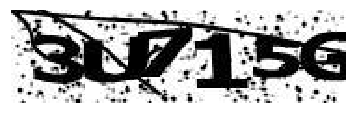

3U715G


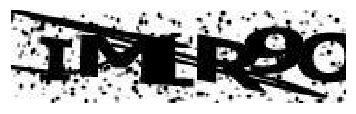

IM1R9O


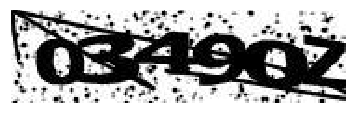

03490Z


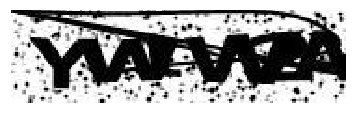

YWIW2A


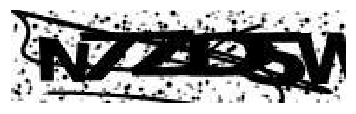

N7ZD5W


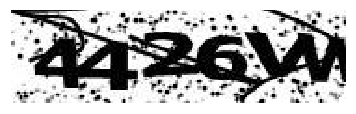

4426VW


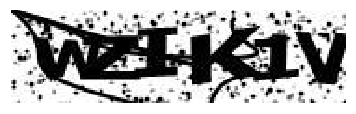

WZIK1V


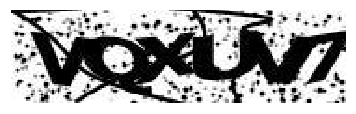

VQXUV7


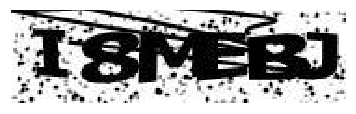

I8MEBJ


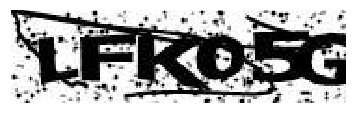

LFK05G


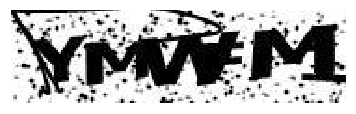

YMWPN1


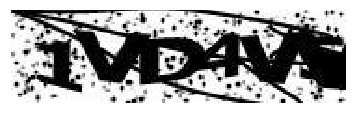

JVD4V5


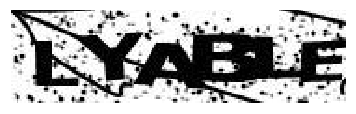

LYABLE


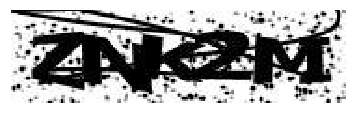

ZNK2MI


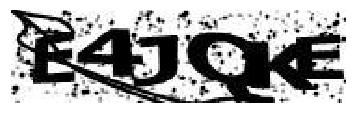

E4JQKE


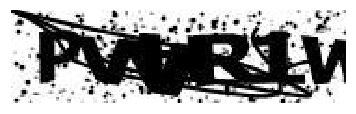

PW?R1W


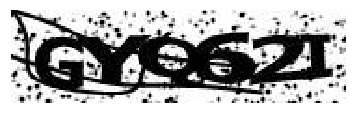

GYQ62I


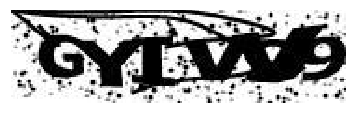

GYIW29


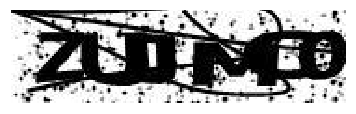

ZUJMC0


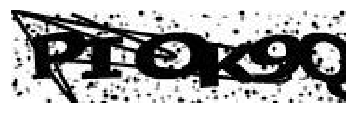

PIOK9Q


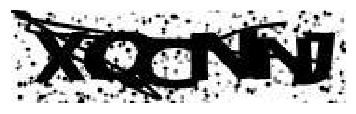

XQCNNJ


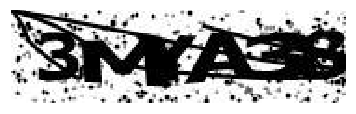

3MYA38


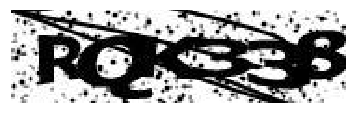

RQK338


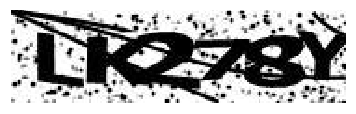

LK278Y


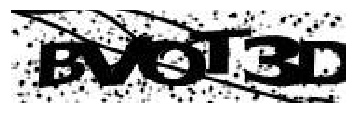

BVOT3D


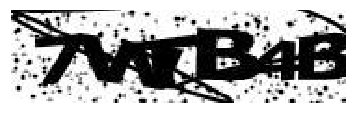

7WTB4B


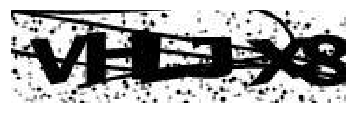

VHLJX8


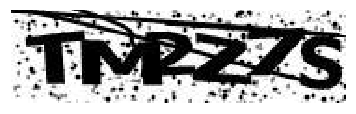

TM2Z7S


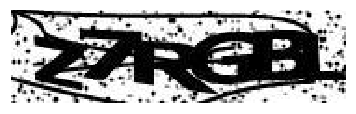

Z7RGBL


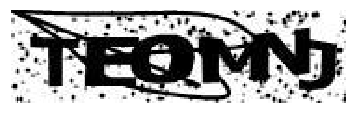

TEOMNJ


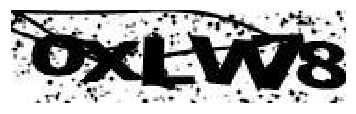

0XLW78


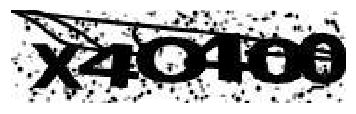

X4O400


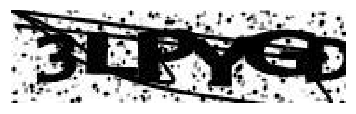

3LPYGD


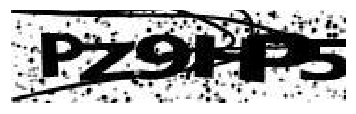

PZ9HP5


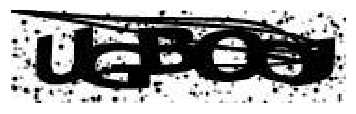

UGPCGJ


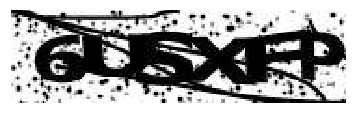

6USXFP


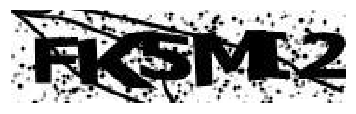

FK5MI2


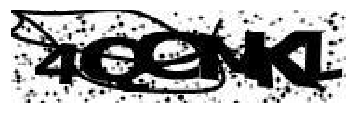

4QGMKL


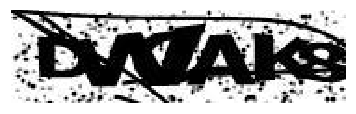

DWOAK8


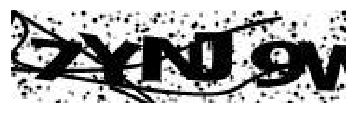

7YNJ9W


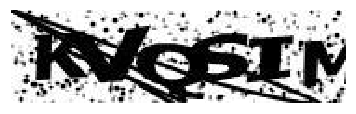

KVOSIM


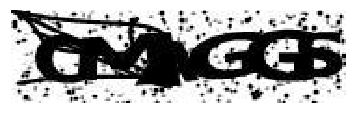

OMAGG5


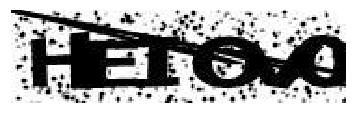

HEIQV0


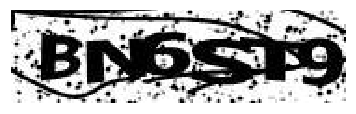

BN6ST9


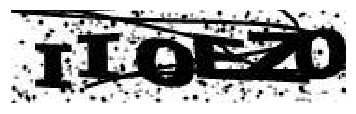

II0EZ0


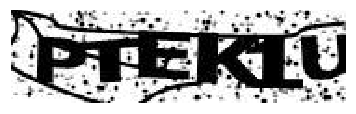

PTEK1U


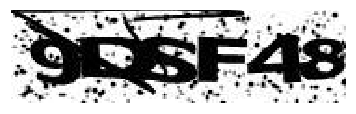

9DSF48


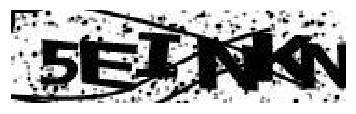

5EINKN


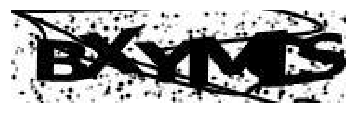

BXYMCS


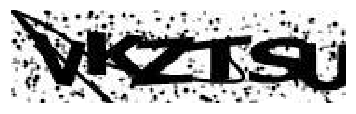

VKZTSU


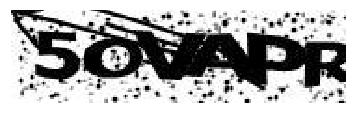

5OVAPR


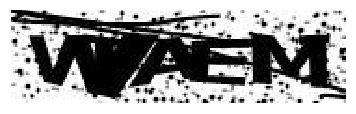

W?AEMI


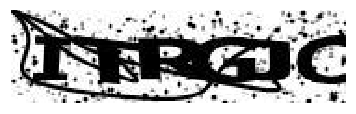

ITRGJC


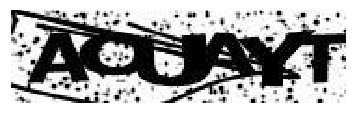

AOUAYT


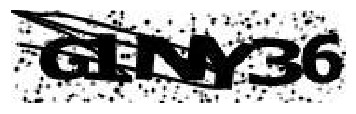

G1NY36


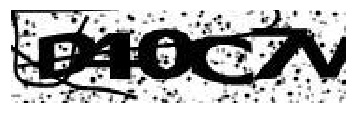

D40C7V


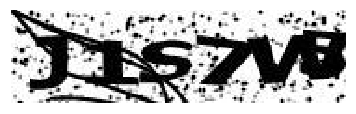

J1S7W6


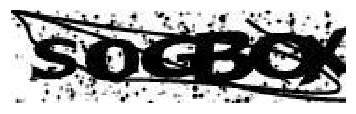

S0GBCX


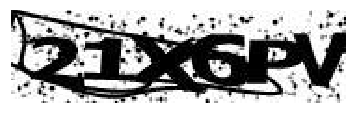

21X6PV


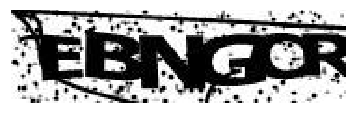

EBNGCR


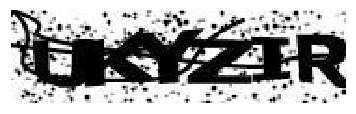

UKYZIR


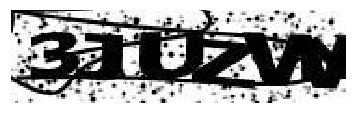

3JUZV?


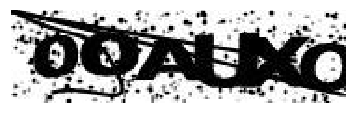

00AUXQ


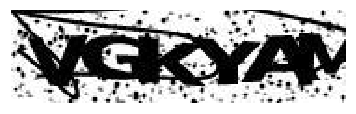

VGKYAM


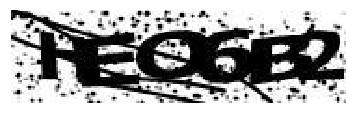

HEO6B2


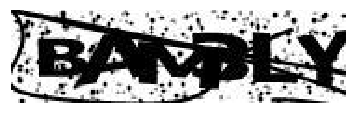

BAM3LY


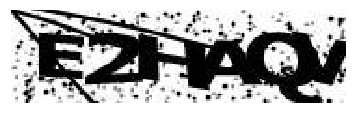

E2HAQV


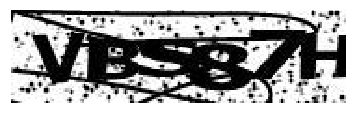

VBS87H


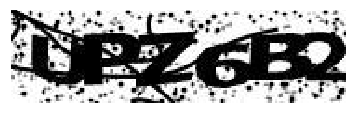

UPZ6B2


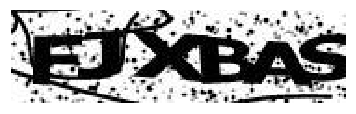

FJXBAS


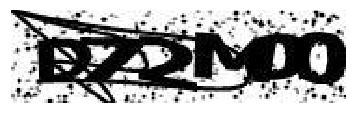

D72M00


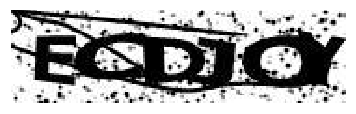

ECDJQY


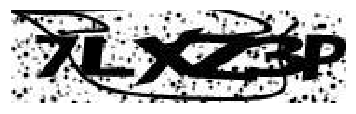

7LXZ3P


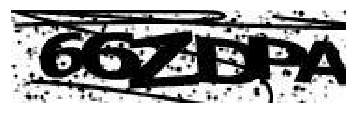

66ZDPA


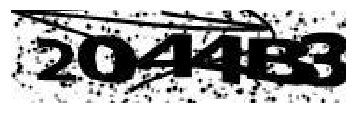

2044B3


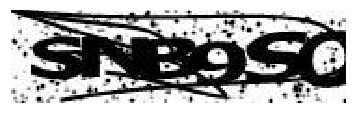

SNB9SQ


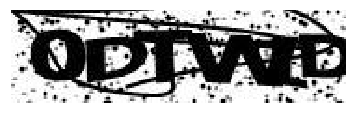

0DTW?D


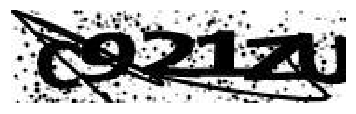

C921ZU


In [14]:
arrayRightAnswers = [0] * 7
i = 0

# Para todos os caracteres da validação
while(i < len(inputTeste)-5):
#     Limpamos as respostas para os acertos e o previsto para o captcha anterior
    rightAnswer = 0
    predictedCaptcha = ''
#     Para cada CAPTCHA
    for charCAPTCHA in range(0,6):
#       Encontra resposta correta para aquele carctere
        currentIndex = i + charCAPTCHA
        shapedOutput = outputTeste[currentIndex:currentIndex+1]
        rightOutput = numpy.argmax(shapedOutput)
        
#       Trata input
        shapedInputTeste = inputTeste[currentIndex:currentIndex+1,:,:]
        shapedInputTeste = shapedInputTeste.reshape(shapedInputTeste.shape[0], 28, 28, 1)
        shapedInputTeste = shapedInputTeste.astype('float32')/255
#       Calcula ouput previsto
        predictedOutput = model.predict(shapedInputTeste, batch_size=None, verbose=0)
        predictedOutput = numpy.argmax(predictedOutput)
        predictedCaptcha += inputList[predictedOutput]

#       Verificamos se a rede acertou a resposta
        if (predictedOutput == rightOutput):
            rightAnswer += 1
            
#   Imprimimos o captcha com a resposta
    
    captchaName = str(currentCaptcha)
    while(len(captchaName) < 6): captchaName = "0" + captchaName

    inputImage = cv2.imread(test_directory + "/" + captchaName + ".jpg")
    printImage(inputImage)
    print(predictedCaptcha)
    
#   Adicionamos o número de acertos do captcha ao vetor de acertos
    arrayRightAnswers[rightAnswer] += 1
    
#   Passamos para o próximo captcha
    i += 6
    currentCaptcha += 1

Calcula a probabilidade de acerto de N caracteres por captcha, onde N é índice do vetor. 

In [15]:
#Imprime previsões corretas
print("Número de caracteres previstos corretamente: ")
print(arrayRightAnswers)
print("\n")
percentMin = [0] * 7
for i in range(0,len(arrayRightAnswers)):
    for n in range(i,len(arrayRightAnswers)):
        percentMin[i] += arrayRightAnswers[n]
    percentMin[i] = percentMin[i]/(len(inputTeste)/6)

#Imprime probabilidade de acertos
print("Probabilidade de acerto de no mínimo N caracteres: ")
print(percentMin)

Número de caracteres previstos corretamente: 
[0, 0, 0, 5, 35, 242, 718]


Probabilidade de acerto de no mínimo N caracteres: 
[1.0, 1.0, 1.0, 1.0, 0.995, 0.96, 0.718]


Imprime o gráfico com o número de acertos mínimos por captcha

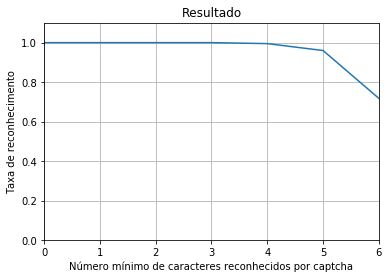

In [16]:
plt.plot(percentMin)
plt.title("Resultado")
plt.grid(True)
plt.ylim([0,1.1])
plt.xlim([0,6])
plt.ylabel("Taxa de reconhecimento")
plt.xlabel("Número mínimo de caracteres reconhecidos por captcha")
plt.show()